In [19]:
from scipy.fft import ifftn
import matplotlib.cm as cm
from __future__ import division 
import numpy as np                      
import sep
import math
import torch
import random
import cv2
from architecture import GraphDeepDecoder, Ups
from deepCR import deepCR
from deepCR import train
from deepCR import roc
from collections import Counter

# additional setup for reading the test image and displaying plots
import fitsio
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.patches import Ellipse

%matplotlib inline

rcParams['figure.figsize'] = [10., 8.]

In [20]:
#turns any matrix into a square matrix
def square_matrix(clean2009):
    clean2009_square = []
    
    for i in range(len(clean2009)):
        clean2009_placeholder = []
        for j in range(len(clean2009)):   
            clean2009_placeholder.append(clean2009[i][j])
        clean2009_square.append(clean2009_placeholder)

    clean2009_square = np.array(clean2009_square)

    return clean2009_square

#creates different levels of noise for one image
def noise_maker(clean, factor):
    noise_test = []
    image_test = []
    input_sets = 3
    
    #this loop creates sets with different levels of noise
    for i in range(input_sets):
        noise_test.append(np.random.randint(0,10, size=clean.shape))
        image_test.append(clean+factor*(i*i/5)*noise_test[i])

    #averages the noise from some images to make a more even distribution 
    image_test[0] = (image_test[1] + image_test[0])/2
    image_test[2] = (image_test[1] + image_test[2])/1.5
    image_noisy = np.array(image_test)

    return image_noisy

#counts the number of stars in an image based on a threshold
def star_counter(sum_average,threshold):
    sum_average = sum_average.astype(np.float32)
   #this cell finds the number of detectable stars in the image using the adaptive row and column averaging method
    sum_average = np.array(sum_average)

    mean_avg, std_avg = np.mean(sum_average), np.std(sum_average)
    sumobjects = sep.extract(sum_average, threshold, clean = False)
    
    # plot background-subtracted image
    fig, ax = plt.subplots()
    im = ax.imshow(sum_average, interpolation='nearest', cmap='gray',
                   vmin = mean_avg-std_avg, vmax=mean_avg+std_avg, origin='lower')
    
    
    #plot an ellipse for each object
    for i in range(len(sumobjects)):
        e = Ellipse(xy=(sumobjects['x'][i], sumobjects['y'][i]),
                    width=6*sumobjects['a'][i],
                    height=6*sumobjects['b'][i],
                    angle=sumobjects['theta'][i] * 180. / np.pi)
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
    
    sumflux, sumfluxerr, sumflag = sep.sum_circle(sum_average, sumobjects['x'], sumobjects['y'],
                                         3.0, gain=1.0)
    plt.show()

    print(len(sumobjects))
    return len(sumobjects)


#finds the stars in an image and saves their positions for plotting
def star_counter_position(sum_average,threshold):
    sum_average = sum_average.astype(np.float32)
   #this cell finds the number of detectable stars in the image using the adaptive row and column averaging method
    sum_average = np.array(sum_average)

    mean_avg, std_avg = np.mean(sum_average), np.std(sum_average)
    sumobjects = sep.extract(sum_average, threshold, clean = False)
    
    # plot background-subtracted image
    fig, ax = plt.subplots()
    im = ax.imshow(sum_average, interpolation='nearest', cmap='gray',
                   vmin = mean_avg-std_avg, vmax=mean_avg+std_avg, origin='lower')
    
    
    #plot an ellipse for each object
    for i in range(len(sumobjects)):
        e = Ellipse(xy=(sumobjects['x'][i], sumobjects['y'][i]),
                    width=6*sumobjects['a'][i],
                    height=6*sumobjects['b'][i],
                    angle=sumobjects['theta'][i] * 180. / np.pi)
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
    
    sumflux, sumfluxerr, sumflag = sep.sum_circle(sum_average, sumobjects['x'], sumobjects['y'],
                                         3.0, gain=1.0)
    plt.show()

    print(len(sumobjects))
    return sumobjects

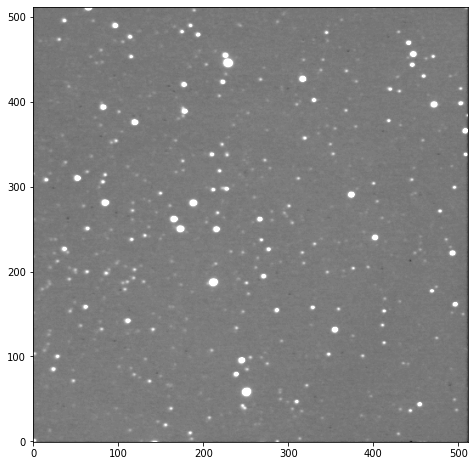

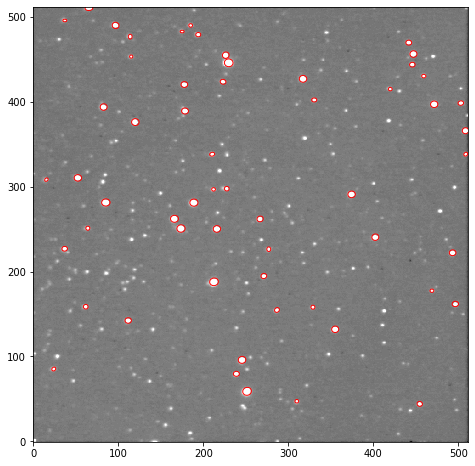

58


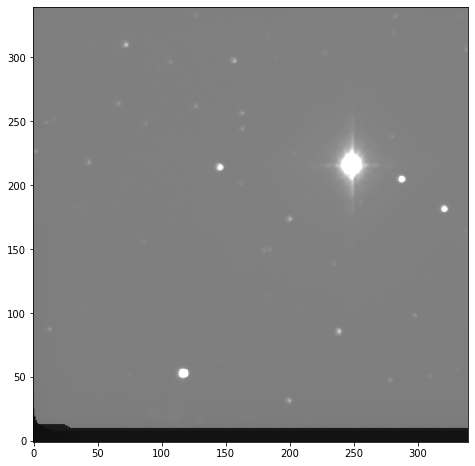

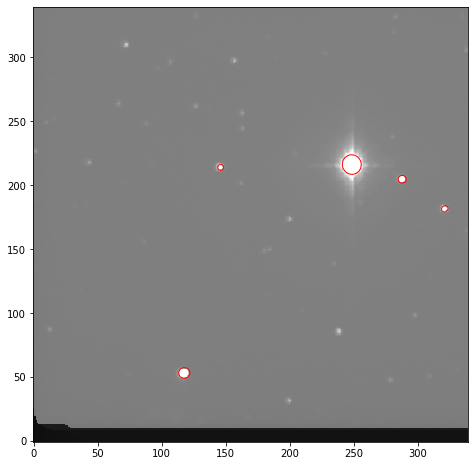

5


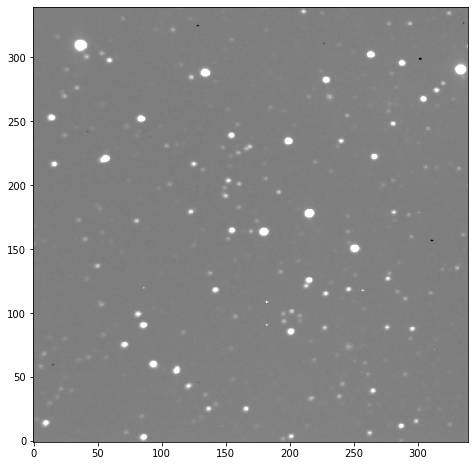

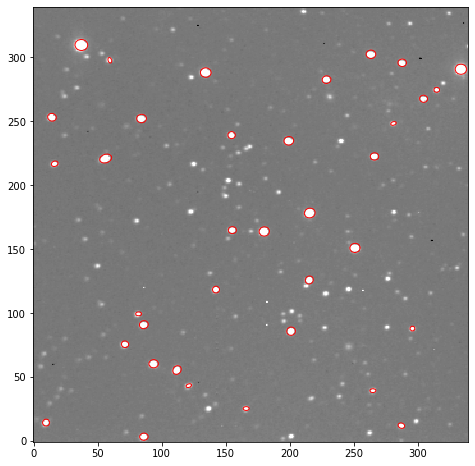

36


In [21]:
#this contains the cleanest version of the images and will be the standard

#holds the number of detected stars in the clean images
clean_starnumbers = []

clean = fitsio.read("v404cyg/shift_median.fit")
m_stand, s_stand = np.mean(clean), np.std(clean)
plt.imshow(clean, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()


cl_clean = star_counter(clean,np.mean(clean)+np.std(clean))


clean2009 = fitsio.read("v404cyg/jul08_2009_median.fit")
clean2009_sq = square_matrix(clean2009)
m_stand2009, s_stand2009 = np.mean(clean2009_sq), np.std(clean2009_sq)
plt.imshow(clean2009_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

cl_clean2009 = star_counter(clean2009_sq,np.mean(clean2009_sq)+np.std(clean2009_sq))

clean2012 = fitsio.read("v404cyg/aug23_2012_median.fit")
clean2012_sq = square_matrix(clean2012)
m_stand2012, s_stand2012 = np.mean(clean2009_sq), np.std(clean2009_sq)
plt.imshow(clean2012_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

cl_clean2012 = star_counter(clean2012_sq,np.mean(clean2012_sq)+np.std(clean2012_sq))


#this is done four times because the first four tests were all done on different levels of noise for this image
clean_starnumbers.append(cl_clean)
clean_starnumbers.append(cl_clean)
clean_starnumbers.append(cl_clean)
clean_starnumbers.append(cl_clean)
clean_starnumbers.append(cl_clean2012)
clean_starnumbers.append(cl_clean2009)

<span style="font-size: 18pt;">Below contains training sets and the function that implements the neural network.</span>


In [22]:
#this cell creates trainging data sets by adding a certain amount of noise to the image
noisy = []
image_list = []
training_sets = 6

image_list = []

#this loop creates sets with different levels of noise
for i in range(training_sets):
    #the list is tansposed so it is not the same as the original images that will be tested
    noisy.append(np.random.randint(0,2, size=clean.shape))
    image_list.append(np.transpose(clean+10*i*i*noisy[i]))

image = np.array(image_list)
mask = np.array(noisy)

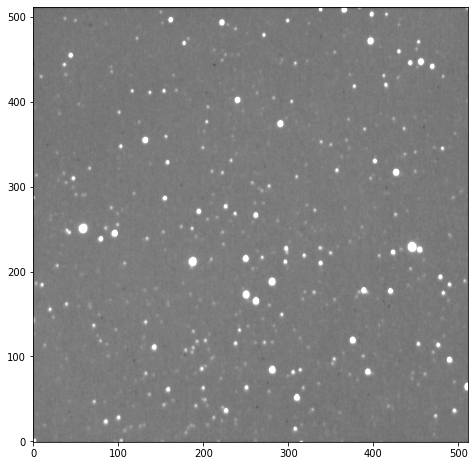

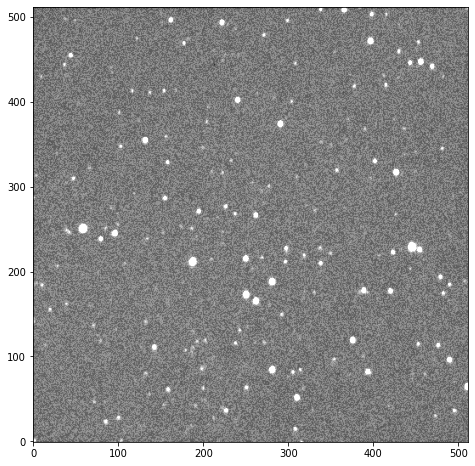

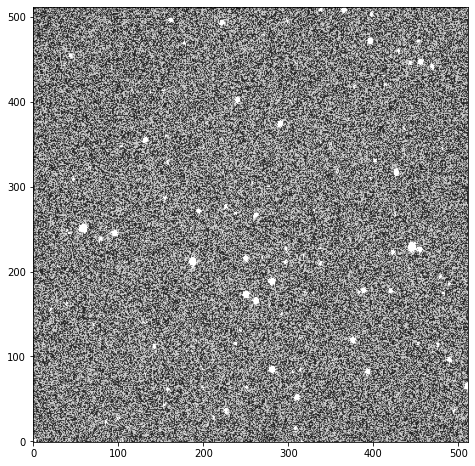

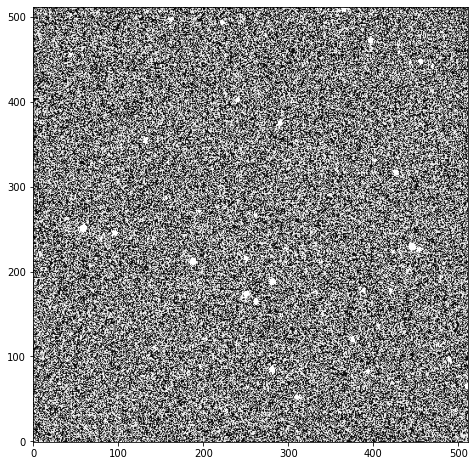

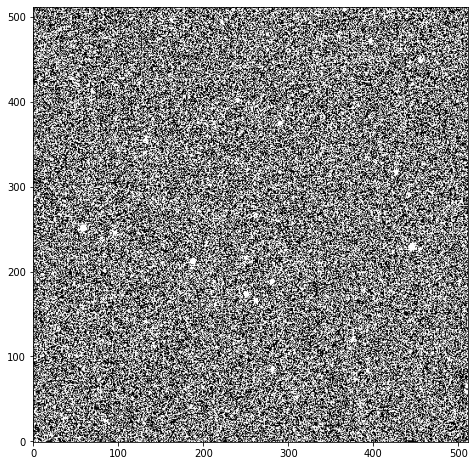

In [23]:
#this displays some of the training data

#print(image_list[1])

mean_de, std_de = np.mean(image_list[0]), np.std(image_list[0])
plt.imshow(image_list[0], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()


mean_de, std_de = np.mean(image_list[1]), np.std(image_list[1])
plt.imshow(image_list[1], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_list[2]), np.std(image_list[2])
plt.imshow(image_list[2], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_list[3]), np.std(image_list[3])
plt.imshow(image_list[3], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_list[4]), np.std(image_list[4])
plt.imshow(image_list[4], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()


In [24]:
#this cell creates trainging data sets by adding varying amounts of noise to each of the image sets
noisy = []
image_list1 = []
image_list2 = []
image_list3 = []
training_sets = 5

new_clean = square_matrix(clean[:340])

#this loop creates sets with different levels of noise
for i in range(training_sets):
    #normalize the clean image so the noise can affect it
    clean_norm = new_clean/(new_clean.max())
    clean2009_norm = clean2009_sq/(clean2009_sq.max())
    clean2012_norm = clean2012_sq/(clean2012_sq.max())

    for j in range(3):
        noisy.append(np.random.randint(0,2, size=new_clean.shape))
    image_list1.append(np.transpose(150*i*clean_norm+clean_norm*25+noisy[i]))
    image_list2.append(np.transpose(150*i*clean2009_norm+clean2009_norm*25+noisy[i]))
    image_list3.append(np.transpose(150*i*clean2012_norm+clean2012_norm*25+noisy[i]))
    
image = []

#combines sets of all three images into one list
image_ln = image_list1 + image_list2 + image_list3
mask_ln = np.array(noisy)

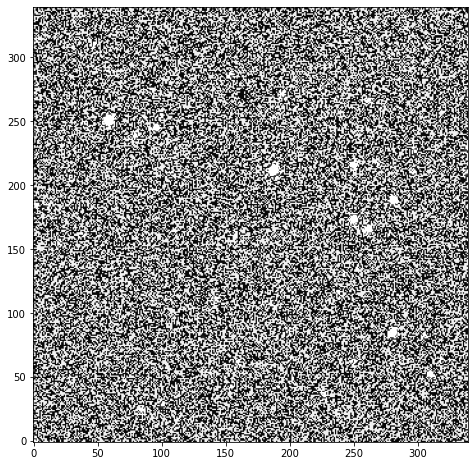

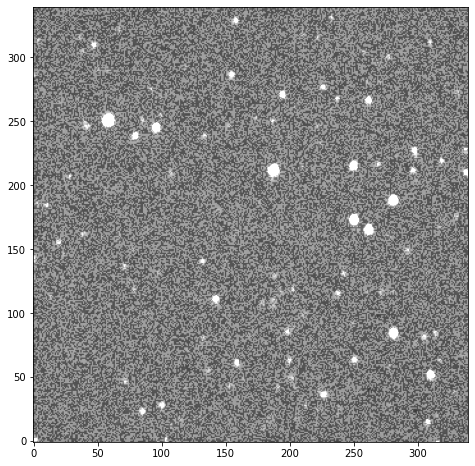

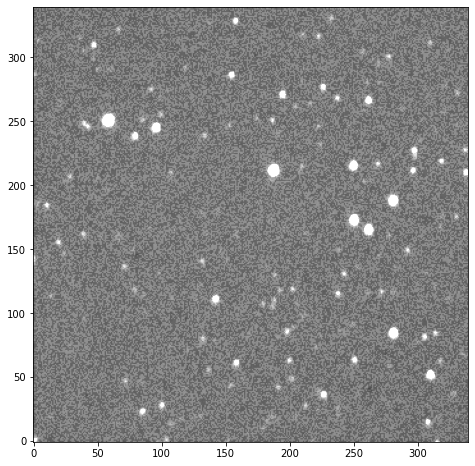

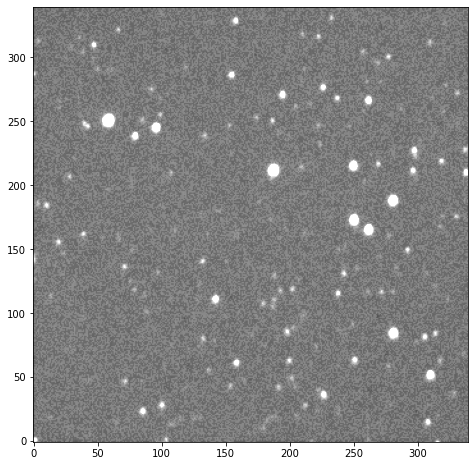

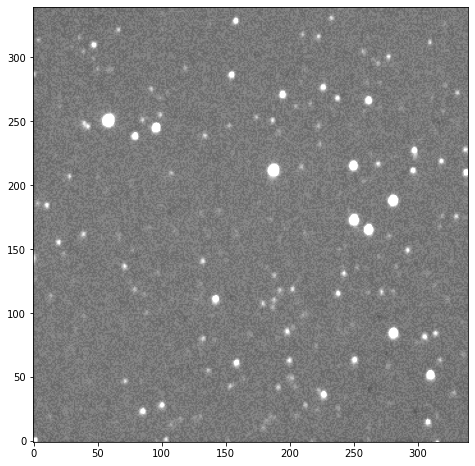

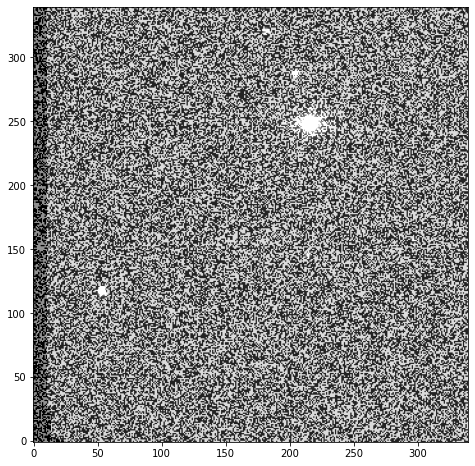

In [25]:
#this cell displays some of the images for the training set

mean_de, std_de = np.mean(image_ln[0]), np.std(image_ln[0])
plt.imshow(image_ln[0], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_ln[1]), np.std(image_ln[1])
plt.imshow(image_ln[1], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_ln[2]), np.std(image_ln[2])
plt.imshow(image_ln[2], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_ln[3]), np.std(image_ln[3])
plt.imshow(image_ln[3], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_ln[4]), np.std(image_ln[4])
plt.imshow(image_ln[4], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()

mean_de, std_de = np.mean(image_ln[5]), np.std(image_ln[5])
plt.imshow(image_ln[5], cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
plt.show()


In [26]:
#this was used to train the NN
#trainer = train(image, mask, name='reverse', gpu=False, epoch=2,
#                save_after=1, plot_every=1, use_tqdm=False)
#trainer.train()
#filename = trainer.save()

In [27]:
# this cell combines the images from the output of the NN together to make a good image
def NeuralNetwork(image_test,input_threshold):
    if(input_threshold > 0.5):
        # create an instance of deepCR with specified model configuration
        mdl = deepCR(mask="2024-03-08_test_epoch5.pth",
        	     inpaint="ACS-WFC-F606W-2-32",
                     device="CPU")
        
        #input image
        
        # apply to input image
        mask2, cleaned_image2 = mdl.clean(image_test, threshold = input_threshold)
        # best threshold is highest value that generate mask covering full extent of CR
        # choose threshold by visualizing outputs.
        
        #print("Input image")
        #mean_de, std_de = np.mean(image_test), np.std(image_test)
        #plt.imshow(image_test, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(image_test)
    
        #print("Background noise")
        cleaned_image = cleaned_image2/100
        #mean_de, std_de = np.mean(cleaned_image), np.std(cleaned_image)
        #plt.imshow(cleaned_image, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(cleaned_image)
    
        #print("Stars")
        #mean_de, std_de = np.mean(mask2), np.std(mask2)
        #plt.imshow(mask2, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(mask2)

        print("Cleaned image")
        clean = mask2*image_test
        mean_de, std_de = np.mean(clean), np.std(clean)
        plt.imshow(clean, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        plt.show()
        #print(clean)
    
        #print("Original image plus stars")
        #this converts the file with the stars out of binary
        #making it relative to the original image
        #new_image = image_test + image_test*mask2
        #mean_de, std_de = np.mean(new_image), np.std(new_image)
        #plt.imshow(new_image, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print("new_image",new_image)
    
        #print("Original image plus stars with noise removed")
        #print("cleaned image")
        #this subtracts the noise from the oiriginal image and the output of the NN
        #then it adds the star file into it  
        #new_image2 = abs(new_image - cleaned_image)
        #mean_de, std_de = np.mean(new_image2), np.std(new_image2)
        #plt.imshow(new_image2, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(new_image2)
    
    else:
        # create an instance of deepCR with specified model configuration
        mdl = deepCR(mask="2024-03-26_three_images_epoch5.pth",
             inpaint="ACS-WFC-F606W-2-32",
                 device="CPU")
    
        
        #input image
        
        # apply to input image
        mask2, cleaned_image2 = mdl.clean(image_test, 0.003)
        # best threshold is highest value that generate mask covering full extent of CR
        # choose threshold by visualizing outputs.

        #this mask has the stars as dark spots, unlike the other mask from 2024-03-08_test_epoch5.pth
        #the below line make the stars the bright spots instead
        mask2 = (mask2 + 1 )% 2
        
        #print("Input image")
        #mean_de, std_de = np.mean(image_test), np.std(image_test)
        #plt.imshow(image_test, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(image_test)
    
        #print("Background noise")
        cleaned_image = cleaned_image2/100
        #mean_de, std_de = np.mean(cleaned_image), np.std(cleaned_image)
        #plt.imshow(cleaned_image, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(cleaned_image)
    
        #print("Stars")
        #mean_de, std_de = np.mean(mask2), np.std(mask2)
        #plt.imshow(mask2, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(mask2)

        print("Cleaned image")
        clean = mask2*image_test
        mean_de, std_de = np.mean(clean), np.std(clean)
        plt.imshow(clean, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        plt.show()
        #print(test)
    
        #print("Original image plus stars")
        #this converts the file with the stars out of binary
        #making it relative to the original image
        #new_image = image_test + image_test*mask2
        #mean_de, std_de = np.mean(new_image), np.std(new_image)
        #plt.imshow(new_image, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print("new_image",new_image)
    
        #print("Original image plus stars with noise removed")
        #print("cleaned image")
        #this subtracts the noise from the oiriginal image and the output of the NN
        #then it adds the star file into it  
        #new_image2 = abs(new_image - cleaned_image)
        #mean_de, std_de = np.mean(new_image2), np.std(new_image2)
        #plt.imshow(new_image2, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
        #plt.show()
        #print(new_image2)

    return cleaned_image,mask2,clean


    
#this implements mathc filtering with an input image and a kernel
def match_filter(noisy_image, kernel_matrix):
    noisy_image = noisy_image.astype(np.float32)

    #print("Input image")
    #mean_de, std_de = np.mean(noisy_image), np.std(noisy_image)
    #plt.imshow(noisy_image, cmap='gray', vmin=mean_de-std_de, vmax=mean_de+std_de, origin='lower')
    #plt.show()
    
    filtered_bad = cv2.filter2D(noisy_image/100, -1, kernel_matrix)
    
    # Calculate mean and standard deviation of the filtered image
    m_bfilt, s_bfilt = np.mean(filtered_bad), np.std(filtered_bad)
    
    # Plot the background-subtracted image
    print("cleaned image")
    fig, ax = plt.subplots()
    im = ax.imshow(filtered_bad, interpolation='nearest', cmap='gray',
                   vmin=m_bfilt - s_bfilt, vmax=m_bfilt + s_bfilt, origin='lower')
    plt.show()

    return filtered_bad

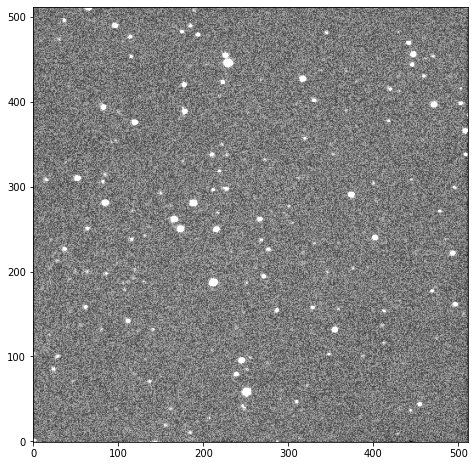

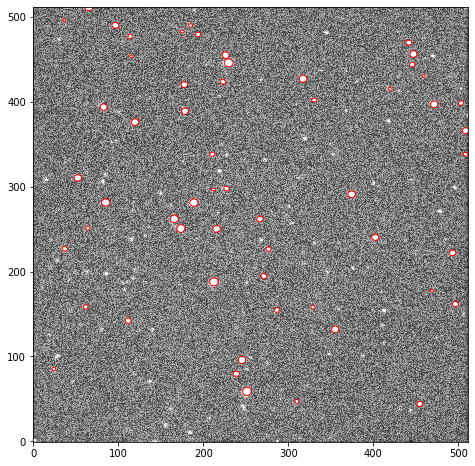

57


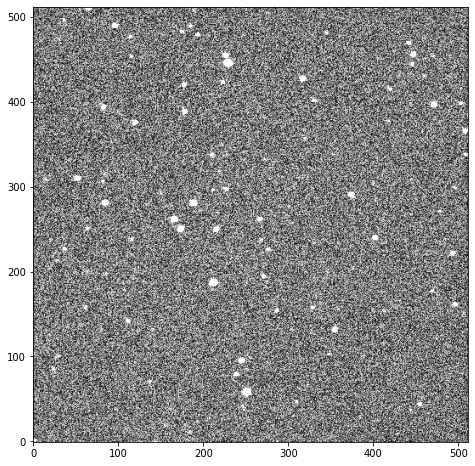

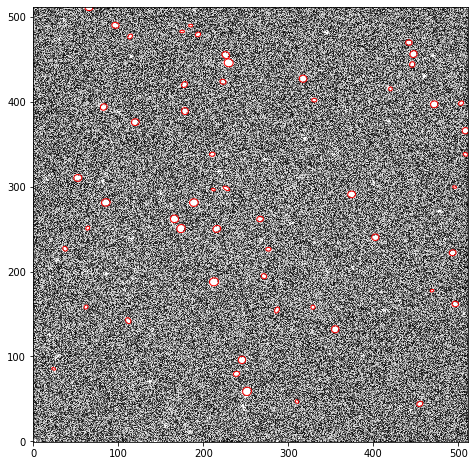

55


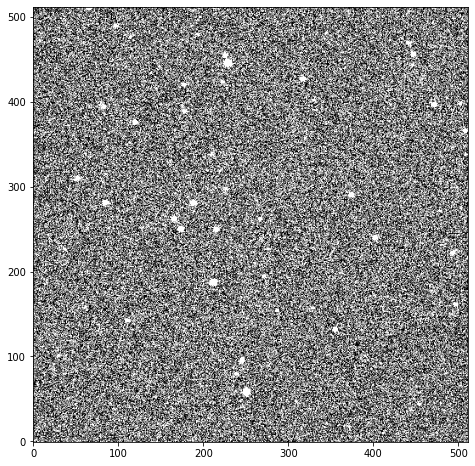

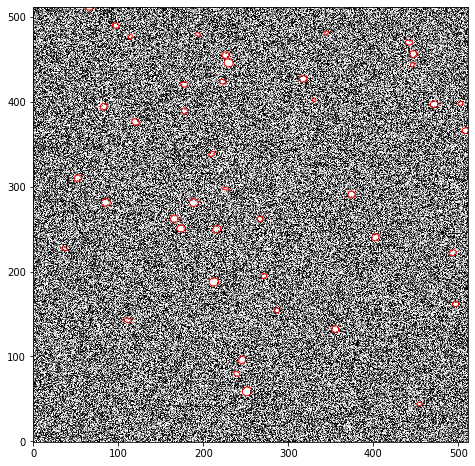

43


In [28]:
#this cell creates new data sets by adding a certain amount of noise to the image
#these will be used to test the NN and match filtering

image_noisy = noise_maker(clean,25)

#lists that will hold the number of stars counted
default = []
mf = []
nn = []


# Display the noisy image
mean, std = np.mean(image_noisy[0]), np.std(image_noisy[0])
plt.imshow(image_noisy[0], cmap='gray', vmin=mean - std, vmax = mean + std, origin='lower')
plt.show()

default_image_noisy0 = star_counter(image_noisy[0],np.mean(image_noisy[0]) + np.std(image_noisy[0]))
default.append(default_image_noisy0)

mean, std = np.mean(image_noisy[1]), np.std(image_noisy[1])
plt.imshow(image_noisy[1], cmap='gray', vmin=mean - std, vmax = mean + std, origin='lower')
plt.show()

default_image_noisy1 = star_counter(image_noisy[1],np.mean(image_noisy[1]) + np.std(image_noisy[1]))
default.append(default_image_noisy1)

mean, std = np.mean(image_noisy[2]), np.std(image_noisy[2])
plt.imshow(image_noisy[2], cmap='gray', vmin=mean - std, vmax = mean + std, origin='lower')
plt.show()

default_image_noisy2 = star_counter(image_noisy[2],np.mean(image_noisy[2]) + np.std(image_noisy[2]))
default.append(default_image_noisy2)

<span style="font-size: 18pt;">The next section is the implementation of noise removal methods.</span>


Cleaned image


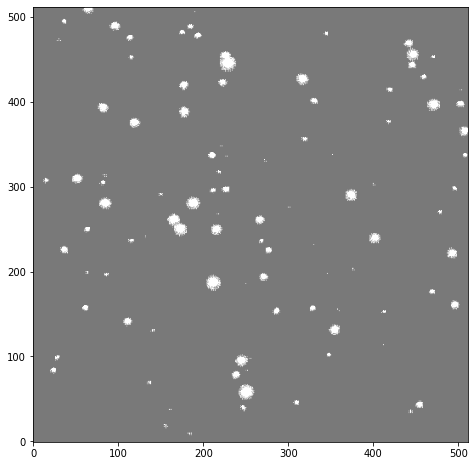

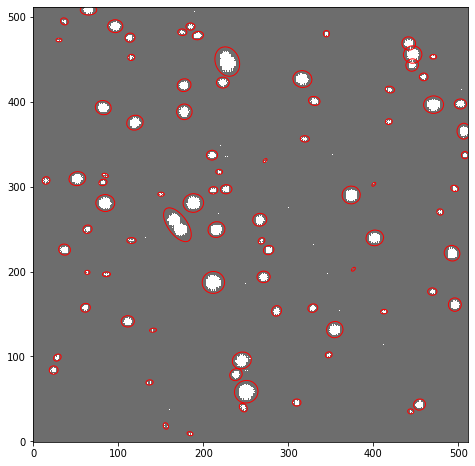

83
Cleaned image


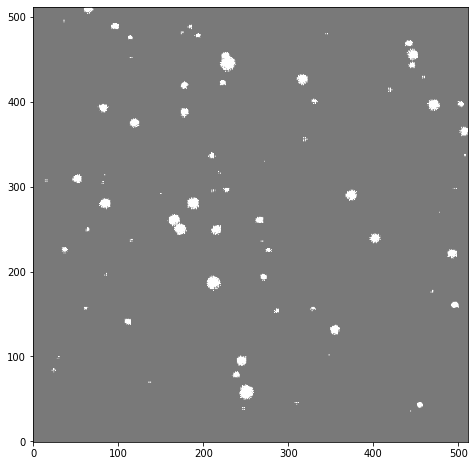

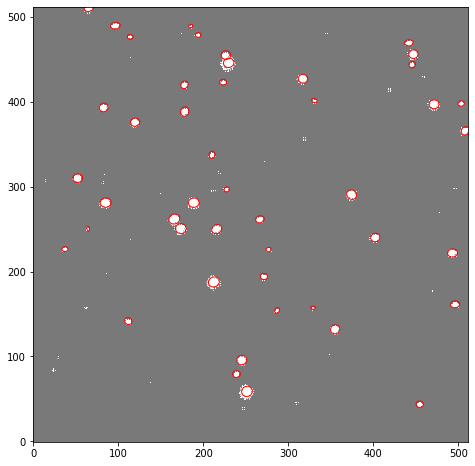

46
Cleaned image


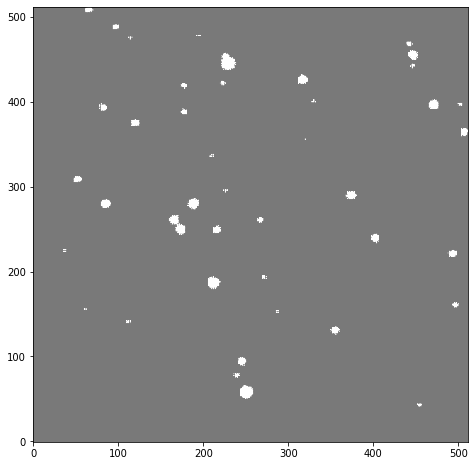

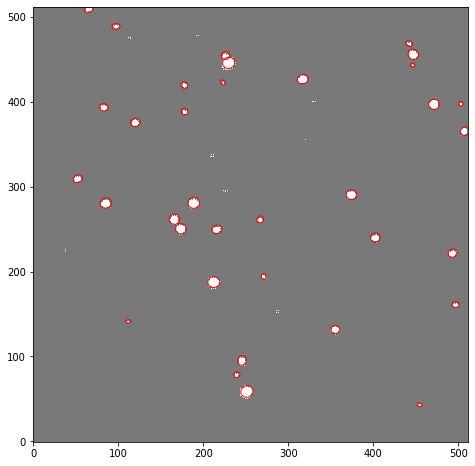

35


In [29]:
#this cell uses the NN to remove the artificial noise from some of the above images
mask0,star0,clean_nn0 = NeuralNetwork(image_noisy[0],0.96)
nn_image_noisy0 = star_counter(star0,np.mean(star0)+np.std(star0))
nn.append(nn_image_noisy0)

mask1,star1,clean_nn1 = NeuralNetwork(image_noisy[1],0.997)
nn_image_noisy1 = star_counter(clean_nn1,np.mean(clean_nn1)+np.std(clean_nn1))
nn.append(nn_image_noisy1)

mask2,star2,clean_nn2 = NeuralNetwork(image_noisy[2],0.9999999)
nn_image_noisy2 = star_counter(clean_nn2,np.mean(clean_nn2)+np.std(clean_nn2))
nn.append(nn_image_noisy2)

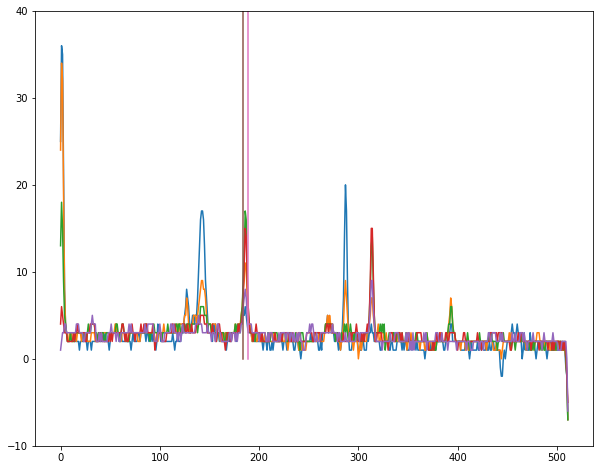

In [30]:
#this cell is used to create a kernel for match filtering

#this will plot some of the first few rows of the clean image
x_clean = np.arange(0,len(clean))
plt.plot(x_clean,clean[1])
plt.plot(x_clean,clean[2])
plt.plot(x_clean,clean[3])
plt.plot(x_clean,clean[4])
plt.plot(x_clean,clean[5])

#starting position in the image
left = 184
#the NxN dimension of the matrix
dimension = 5
right = left+dimension

#move to the desired position in the original matrix
y_left = []
y_right = []
for i in range(len(clean)):
    y_left.append(left)
    y_right.append(right)

plt.plot(y_left,x_clean)
plt.plot(y_right,x_clean)
plt.ylim(-10,40)

#this fills in the values from the clean lists to create a matrix that goes over a few of clean's rows and columns
kernel_bright = []
kernel_dark = []
for j in range(1,dimension+1):
    brightkernel_placeholder = []
    darkkernel_placeholder = []
    for k in range(left,right):
        brightkernel_placeholder.append(clean[j][k])
        darkkernel_placeholder.append(clean[512-j][512-k])
    kernel_bright.append(brightkernel_placeholder)
    kernel_dark.append(darkkernel_placeholder)

#displays a few rows of brightness from the image
kernel_brightnp = np.array(kernel_bright)
kernel_darknp = np.array(kernel_dark)

plt.show()

cleaned image


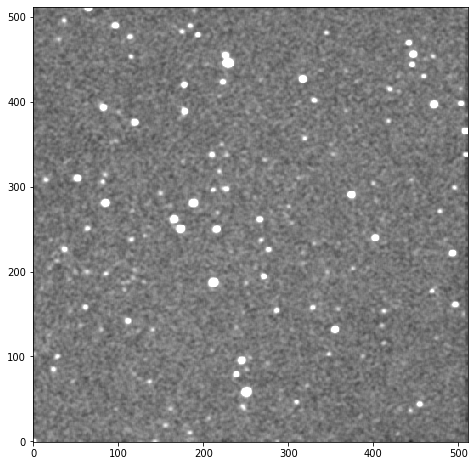

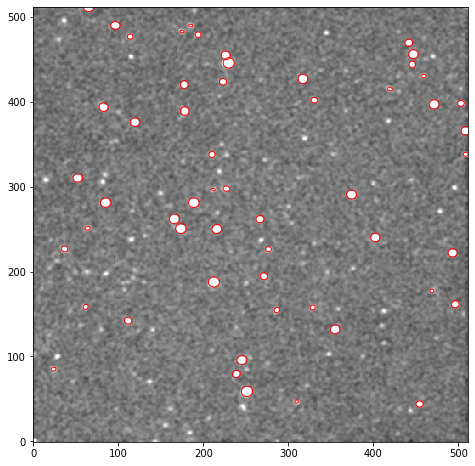

55
cleaned image


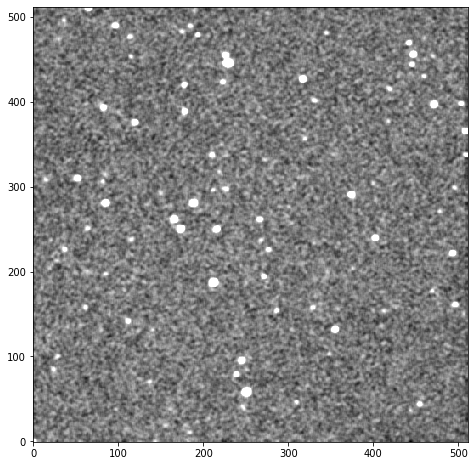

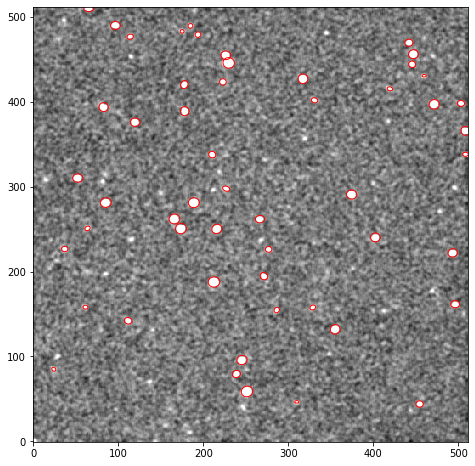

53
cleaned image


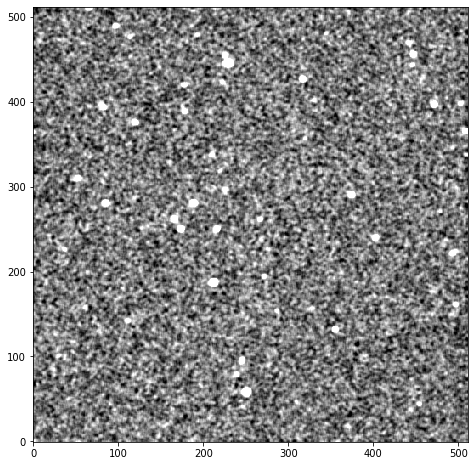

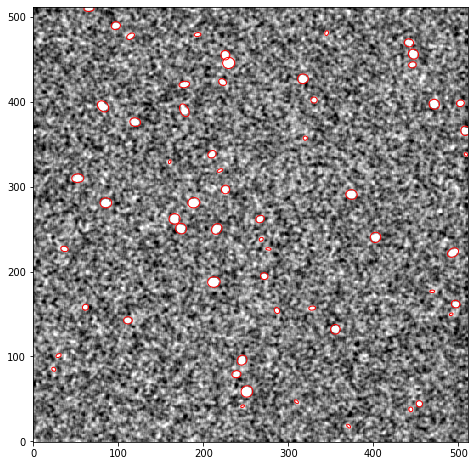

59


In [31]:
#this implements match filtering on the images with artificial noise
clean_mf0 = match_filter(image_noisy[0], kernel_brightnp)
mf_image_noisy0 = star_counter(clean_mf0,np.mean(clean_mf0)+np.std(clean_mf0))
mf.append(mf_image_noisy0)

clean_mf1 = match_filter(image_noisy[1], kernel_brightnp)
mf_image_noisy1 = star_counter(clean_mf1,np.mean(clean_mf1)+np.std(clean_mf1))
mf.append(mf_image_noisy1)

clean_mf2 = match_filter(image_noisy[2], kernel_brightnp)
mf_image_noisy2 = star_counter(clean_mf2,np.mean(clean_mf2)+np.std(clean_mf2))
mf.append(mf_image_noisy2)

<span style="font-size: 18pt;">The below section involves calulating the entropy and probability distributions.</span>


In [32]:
#clean[0] gets the first row of clean

#this cell takes the matrix and puts all its pixel values into a list so a probability distribution can be created
def prob_dist(clean):
    #fills in the pixel values into a single matrix
    clean_pixels = []
    for i in range(len(clean)):
        for j in range(len(clean)):
            #puts all the matrix values in one list
            clean_pixels.append(clean[i][j])

    #makes that list into a dictionary
    clean_pixeldict = Counter(clean_pixels)
    clean_pixelval = list(clean_pixeldict.keys())
    clean_pixelcount = list(clean_pixeldict.values())
    
    clean_pixelprob = []

    #creates the probability of each value
    for i in range(len(clean_pixelcount)):
        clean_pixelprob.append(clean_pixelcount[i]/len(clean_pixels))

    return clean_pixelprob, clean_pixelval, clean_pixelcount

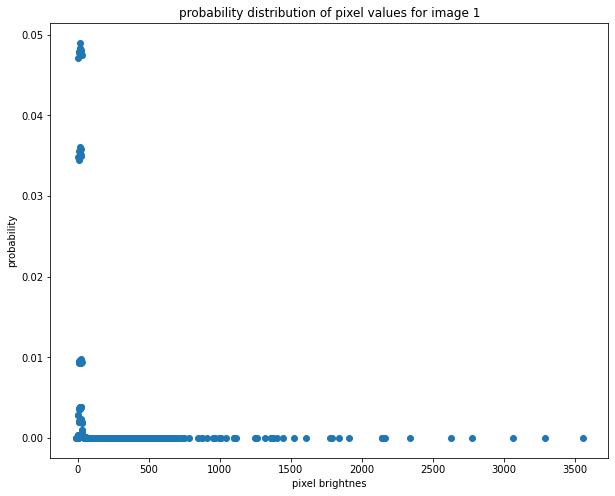

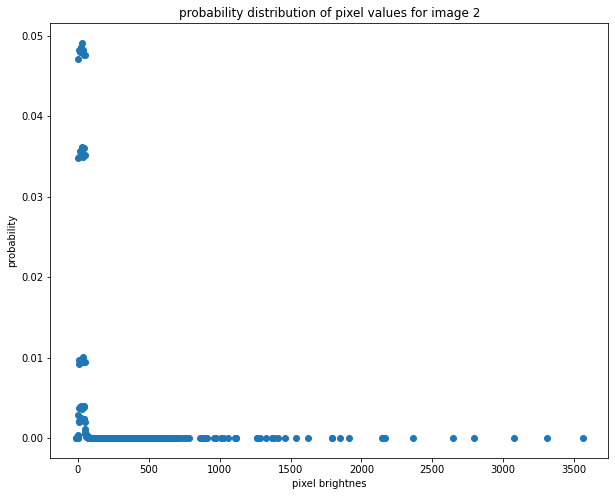

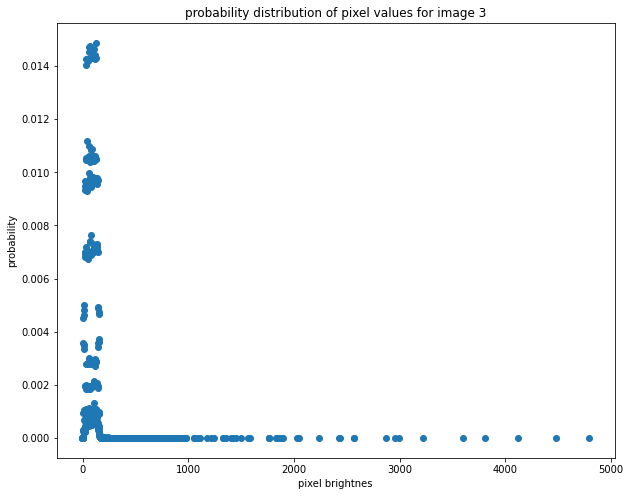

In [33]:
#this cell shows the probability distributions of the noisy images before they are cleaned
noise0_prob, noise0_val, noise0_count = prob_dist(image_noisy[0])
noise1_prob, noise1_val, noise1_count = prob_dist(image_noisy[1])
noise2_prob, noise2_val, noise2_count = prob_dist(image_noisy[2])

plt.scatter(noise0_val,noise0_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values for image 1")
plt.show()

plt.scatter(noise1_val,noise1_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values for image 2")
plt.show()

plt.scatter(noise2_val,noise2_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values for image 3")
plt.show()

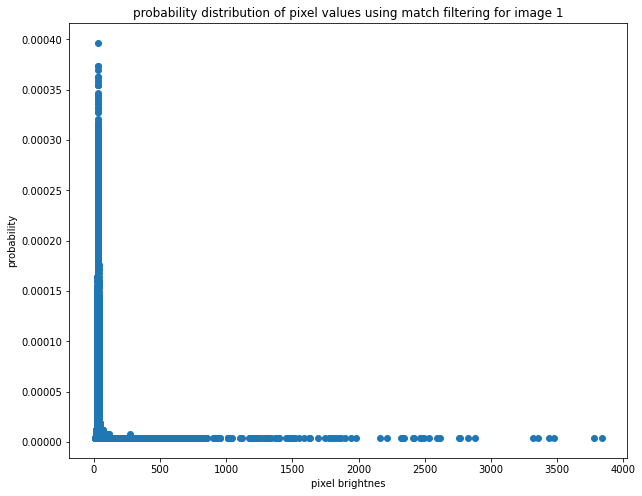

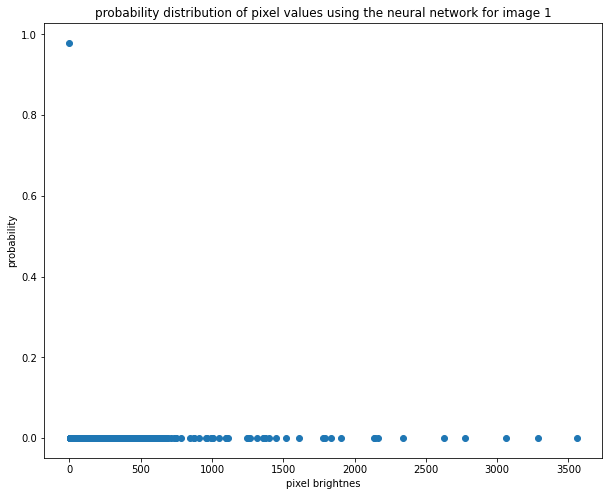

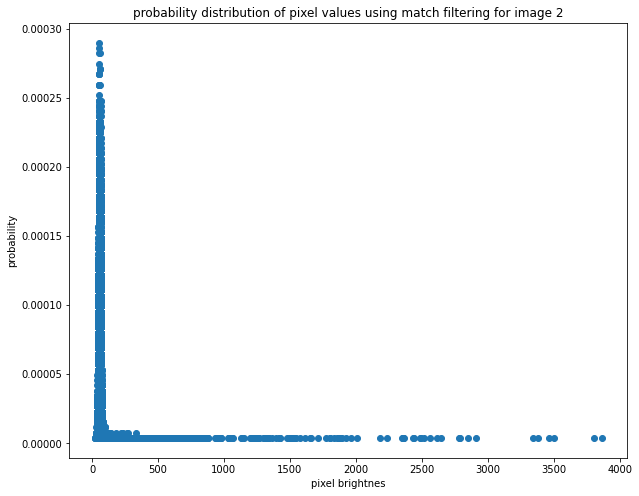

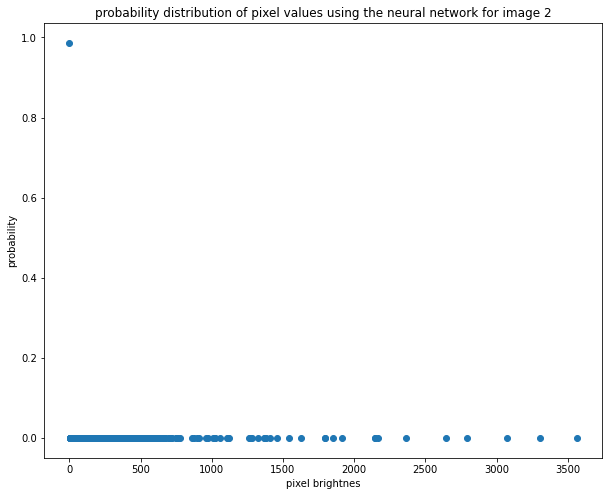

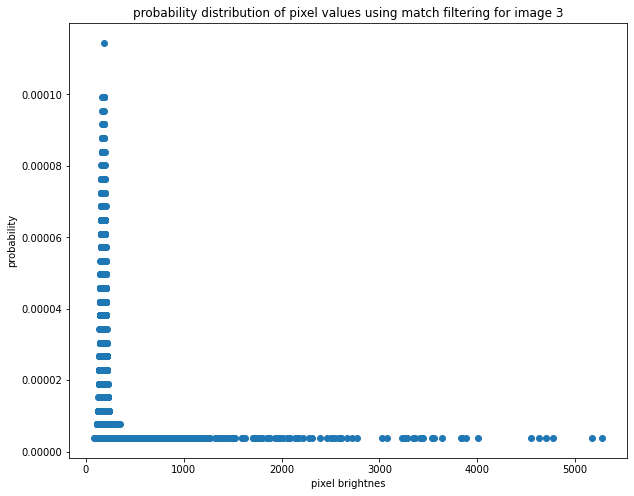

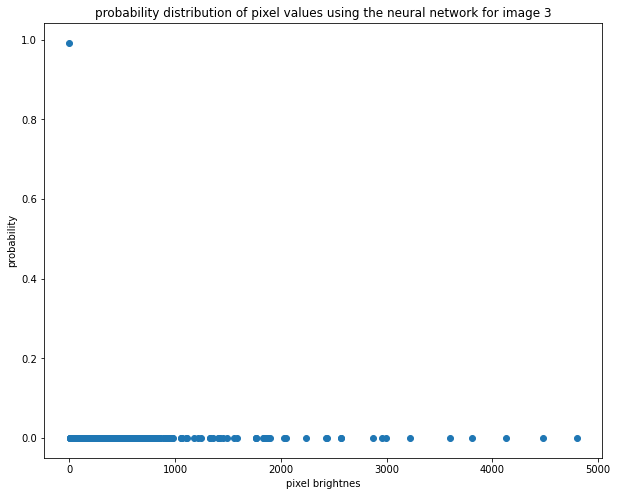

In [34]:
#this cell shows the probability distributions of the noisy images after they are cleaned
#mf = match filter, nn= neural network

cleanmf0_prob, cleanmf0_val, cleanmf0_count = prob_dist(clean_mf0)
cleanmf1_prob, cleanmf1_val, cleanmf1_count = prob_dist(clean_mf1)
cleanmf2_prob, cleanmf2_val, cleanmf2_count = prob_dist(clean_mf2)

cleannn0_prob, cleannn0_val, cleannn0_count = prob_dist(clean_nn0)
cleannn1_prob, cleannn1_val, cleannn1_count = prob_dist(clean_nn1)
cleannn2_prob, cleannn2_val, cleannn2_count = prob_dist(clean_nn2)

plt.scatter(cleanmf0_val,cleanmf0_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using match filtering for image 1")
plt.show()

plt.scatter(cleannn0_val,cleannn0_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using the neural network for image 1")
plt.show()

plt.scatter(cleanmf1_val,cleanmf1_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using match filtering for image 2")
plt.show()

plt.scatter(cleannn1_val,cleannn1_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using the neural network for image 2")
plt.show()

plt.scatter(cleanmf2_val,cleanmf2_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using match filtering for image 3")
plt.show()

plt.scatter(cleannn2_val,cleannn2_prob)
plt.xlabel("pixel brightnes")
plt.ylabel("probability")
#plt.xscale('log') 
#plt.yscale('log') 
plt.title("probability distribution of pixel values using the neural network for image 3")
plt.show()

Text(0, 0.5, 'Entropy')

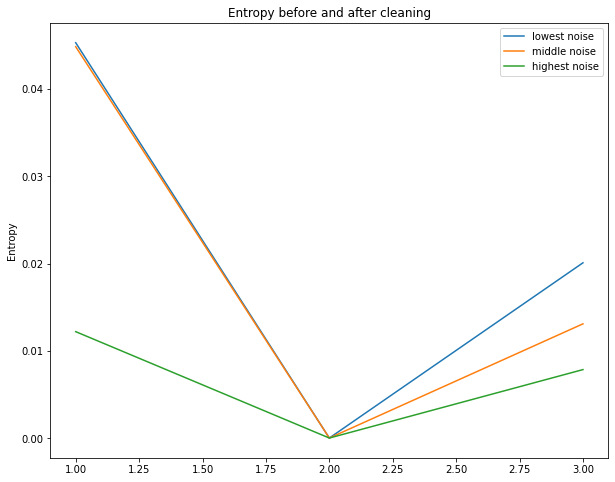

In [35]:
#this cell calculates the entropy of both the neural network and match filtering method for each of the three images

def entropy(noise0_prob):
    entropy = 0
    for i in range(len(noise0_prob)):
        entropy += -(noise0_prob[i]*math.log(noise0_prob[i]))
        return entropy
    
#entropy of the noisy images
noise0_ent = entropy(noise0_prob)
noise1_ent = entropy(noise1_prob)
noise2_ent = entropy(noise2_prob)

#entropy of the match filtered images
cleanmf0_ent = entropy(cleanmf0_prob)
cleanmf1_ent = entropy(cleanmf1_prob)
cleanmf2_ent = entropy(cleanmf2_prob)

#entropy of the neural network images
cleannn0_ent = entropy(cleannn0_prob)
cleannn1_ent = entropy(cleannn1_prob)
cleannn2_ent = entropy(cleannn2_prob)

x = [1,2,3]
y0 = [noise0_ent,cleanmf0_ent,cleannn0_ent]

y1 = [noise1_ent,cleanmf1_ent,cleannn1_ent]

y2 = [noise2_ent,cleanmf2_ent,cleannn2_ent]

plt.plot(x,y0, label = "lowest noise")
plt.plot(x,y1, label = "middle noise")
plt.plot(x,y2, label = "highest noise")
plt.title("Entropy before and after cleaning")

plt.legend()
plt.ylabel("Entropy")
#1 = clean image
#2 = match filtered image
#3 = image after NN

KL divergence can't be calcualted because the sets have a different number of elements. Also their output values are not equal, some have slightly brighter or dimmer values

<span style="font-size: 18pt;">Below Tests the neural network and match filtering on images with real noise based on exposure.</span>


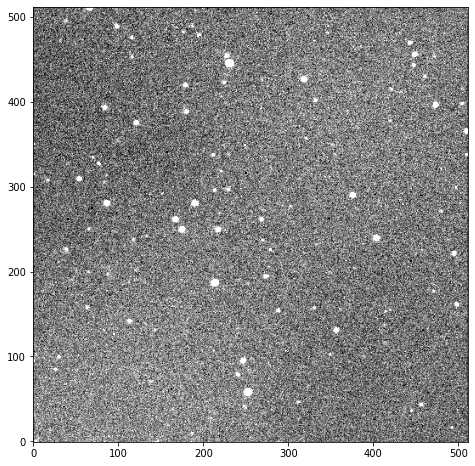

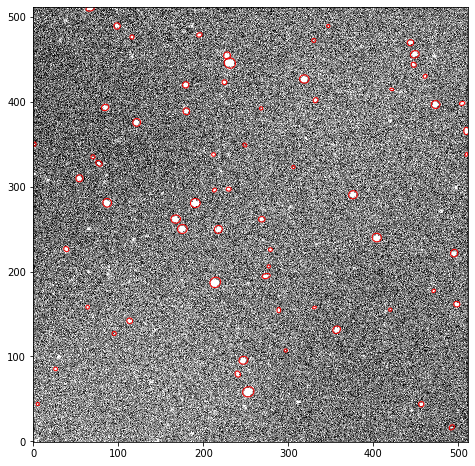

65
cleaned image


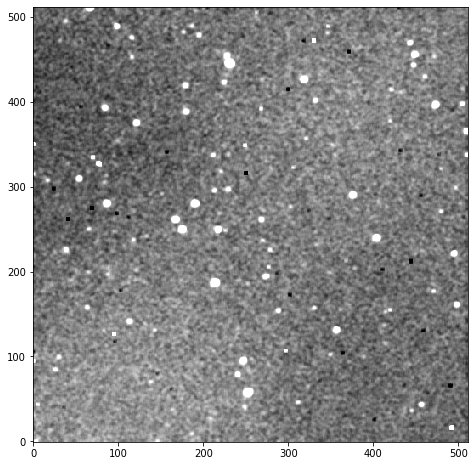

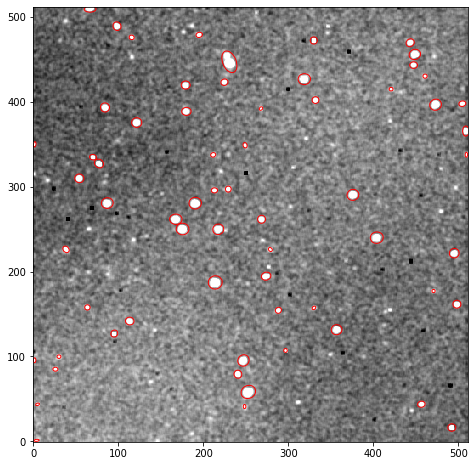

64
Cleaned image


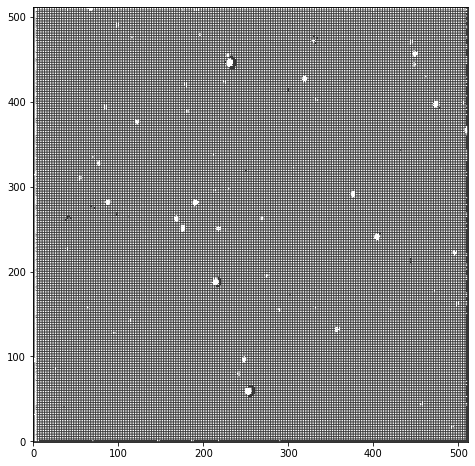

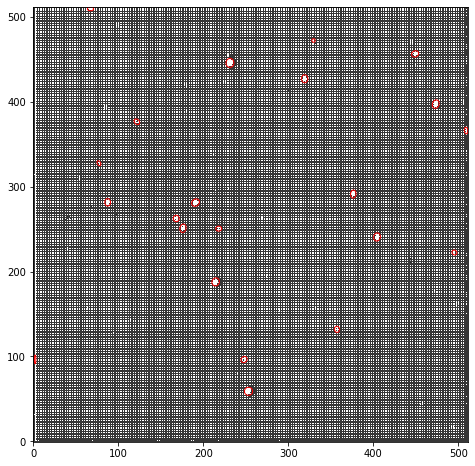

22


In [36]:
#this implementation is the noisiest v404 image
v404 = fitsio.read("v404cyg/v404cyg_v-414.fit")
m_stand, s_stand = np.mean(v404), np.std(v404)
plt.imshow(v404, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

default_v404 = star_counter(v404,np.mean(v404)+np.std(v404))
default.append(default_v404)

v404_mf = match_filter(v404, kernel_brightnp)

mf_v404 = star_counter(v404_mf,np.mean(v404_mf)+np.std(v404_mf))
mf.append(mf_v404)

maskv404,starv404,clean_nnv404 = NeuralNetwork(v404,0.003)

nn_v404 = star_counter(clean_nnv404,np.mean(clean_nnv404)+np.std(clean_nnv404))
nn.append(nn_v404)

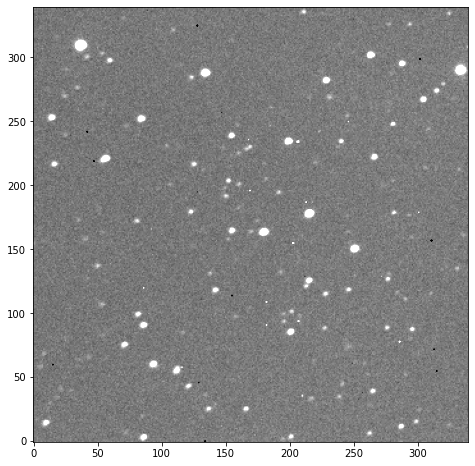

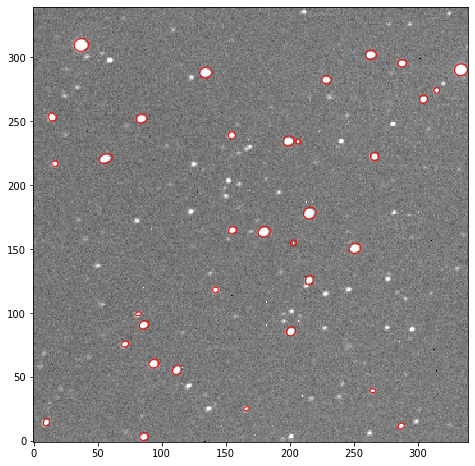

34
cleaned image


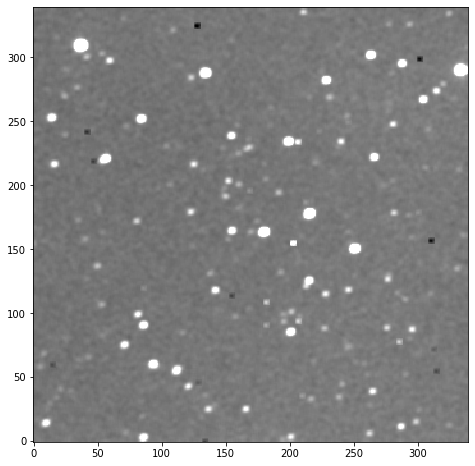

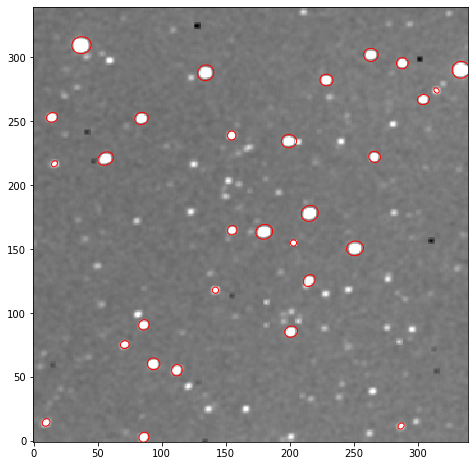

30
Cleaned image


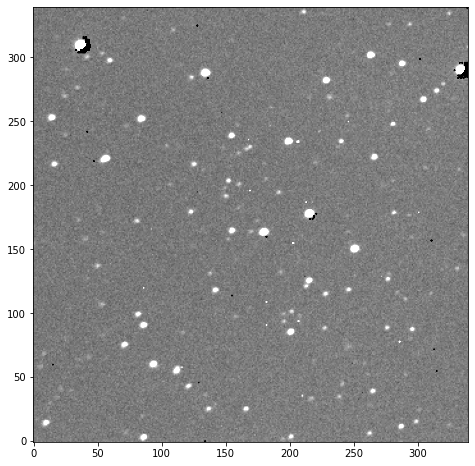

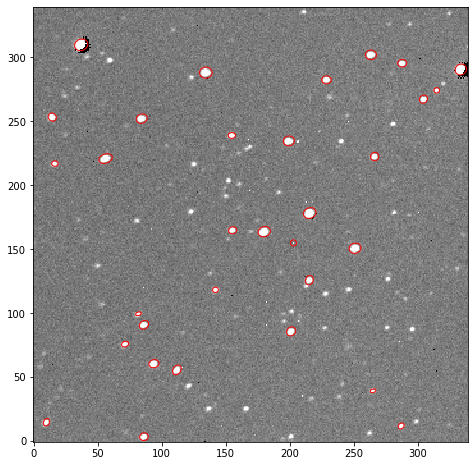

32


In [37]:
#this implementation is the noisiest august1012 image
aug2012 = fitsio.read("aug23_2012/css2039_clear-180.fit")
aug2012 = square_matrix(aug2012)
m_stand, s_stand = np.mean(aug2012), np.std(aug2012)
plt.imshow(aug2012, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

default_aug2012 = star_counter(aug2012,np.mean(aug2012)+np.std(aug2012))
default.append(default_aug2012)

aug2012_mf = match_filter(aug2012, kernel_brightnp)

mf_aug2012 = star_counter(aug2012_mf,np.mean(aug2012_mf)+np.std(aug2012_mf))
mf.append(mf_aug2012)

maskaug2012,staraug2012,clean_nnaug2012 = NeuralNetwork(aug2012,.3)

nn_aug2012 = star_counter(clean_nnaug2012,np.mean(clean_nnaug2012)+np.std(clean_nnaug2012))
nn.append(nn_aug2012)

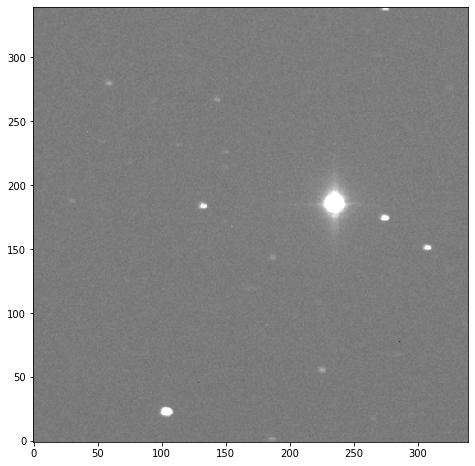

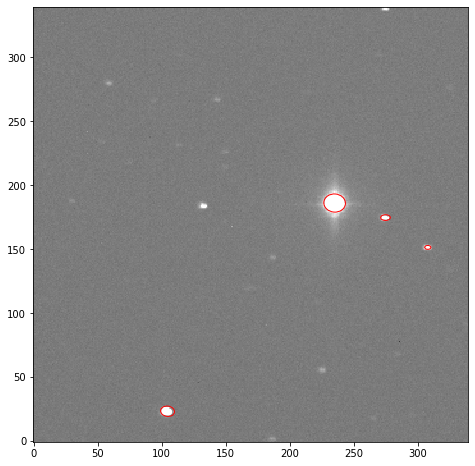

4
cleaned image


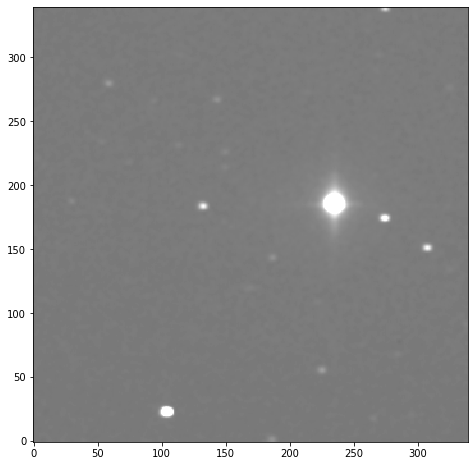

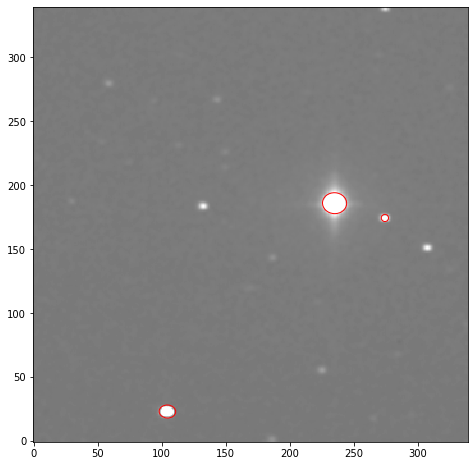

3
Cleaned image


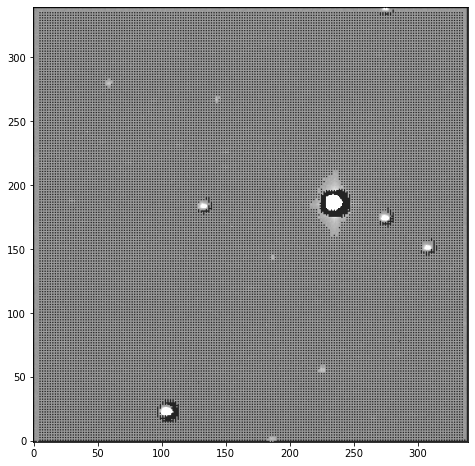

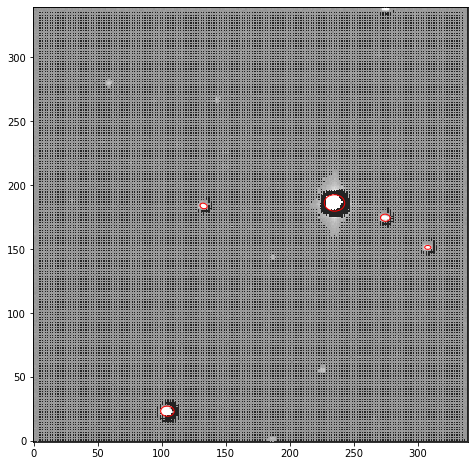

5


In [38]:
#this implementation is the noisiest jul2009 image
jul2009 = fitsio.read("jul08_2009/rxj-643.fit")
jul2009 = square_matrix(jul2009)
m_stand, s_stand = np.mean(jul2009), np.std(jul2009)
plt.imshow(jul2009, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

default_jul2009 = star_counter(jul2009,np.mean(jul2009)+np.std(jul2009))
default.append(default_jul2009)

jul2009_mf = match_filter(jul2009, kernel_brightnp)

mf_jul2009 = star_counter(jul2009_mf,np.mean(jul2009_mf)+np.std(jul2009_mf))
mf.append(mf_jul2009)

maskjul2009,starjul2009,clean_nnjul2009 = NeuralNetwork(jul2009,0.029)

nn_jul2009 = star_counter(clean_nnjul2009,np.mean(clean_nnjul2009)+np.std(clean_nnjul2009))
nn.append(nn_jul2009)

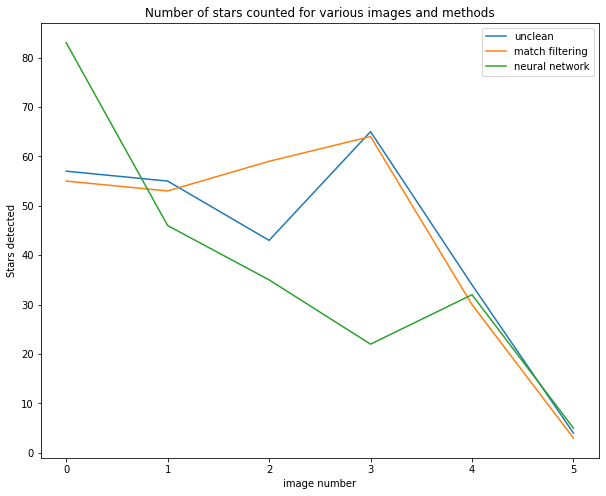

In [39]:
#this shows the number of stars detected for each removal method
#the frist three images contain artifiical noise and the last three are the real images

placeholder = []
for i in range(len(default)):
    placeholder.append(i)

#plt.plot(placeholder,clean_starnumbers, label = "clean")
plt.plot(placeholder,default, label = "unclean")
plt.plot(placeholder,mf, label = "match filtering")
plt.plot(placeholder,nn, label = "neural network")
plt.xlabel("image number")
plt.ylabel("Stars detected")
plt.title("Number of stars counted for various images and methods")
plt.legend()
plt.show()

<span style="font-size: 18pt;">The below section involves global motion.</span>


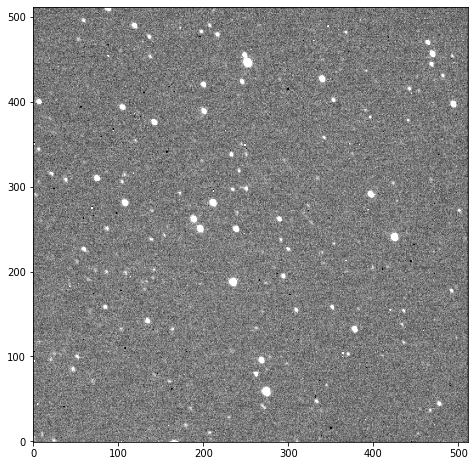

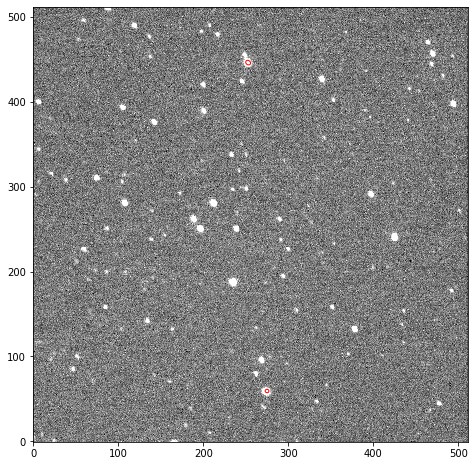

2


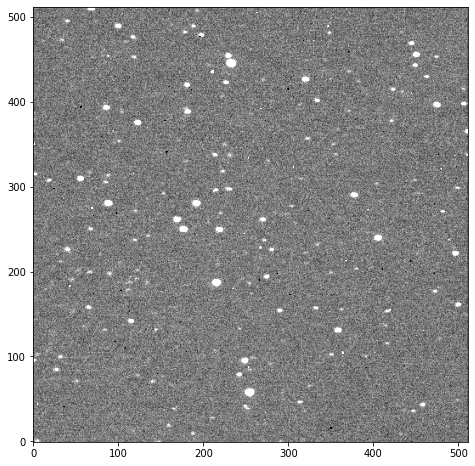

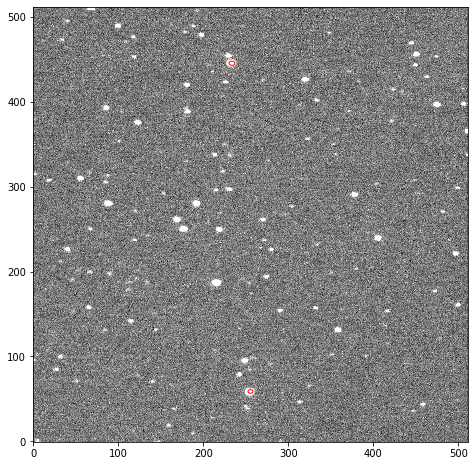

2


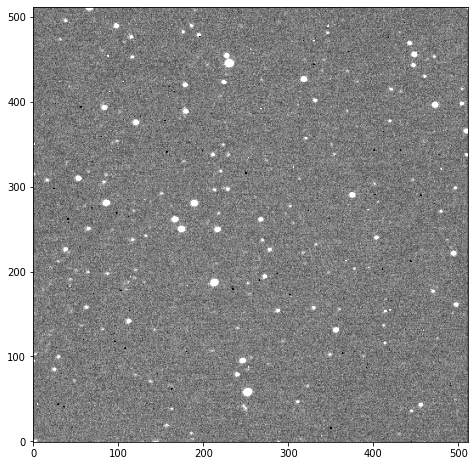

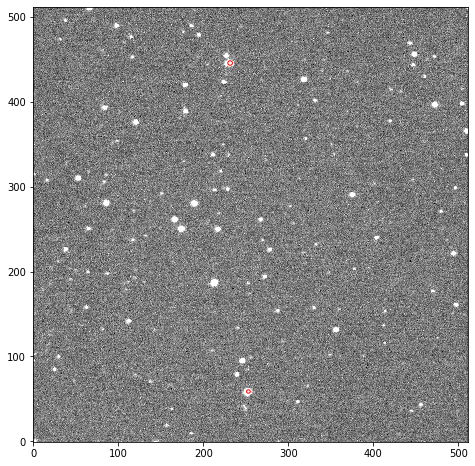

2


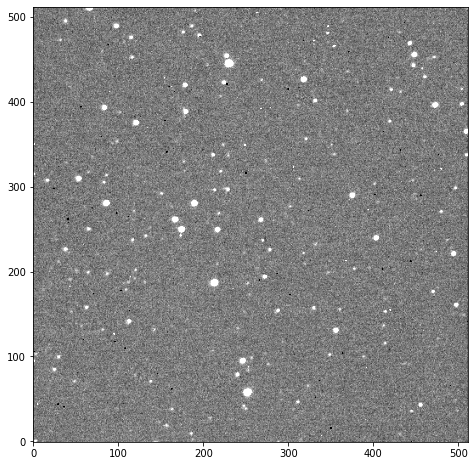

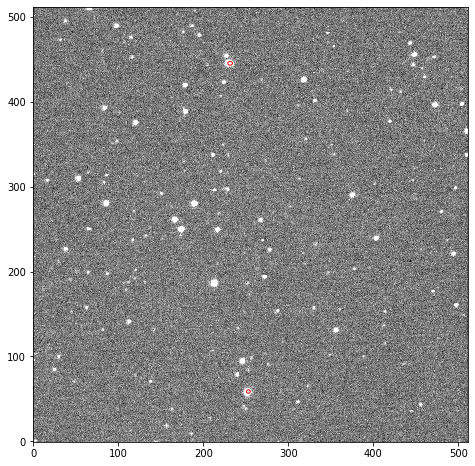

2


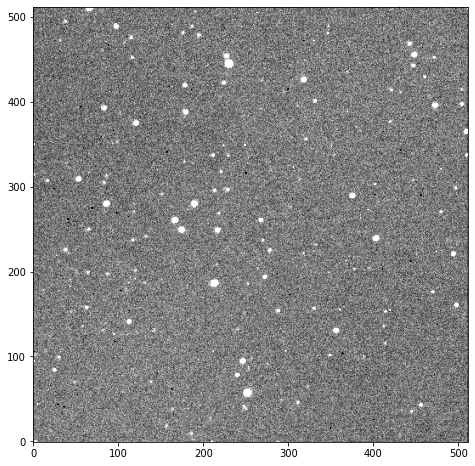

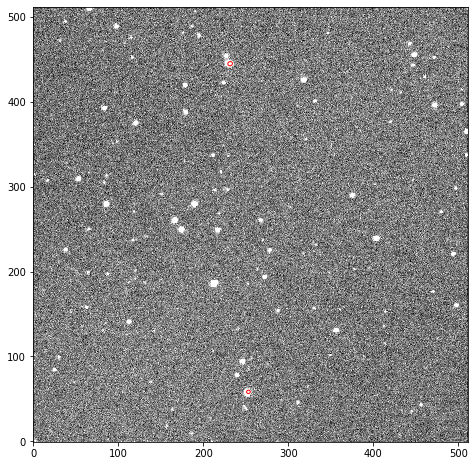

2


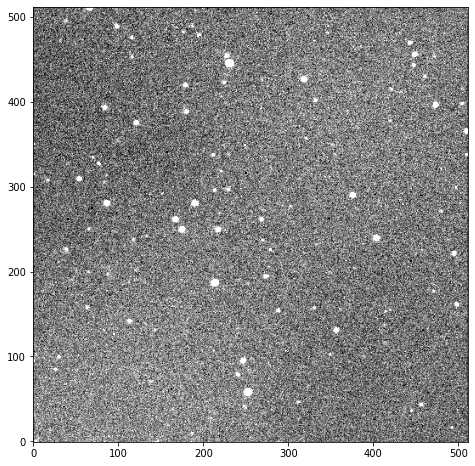

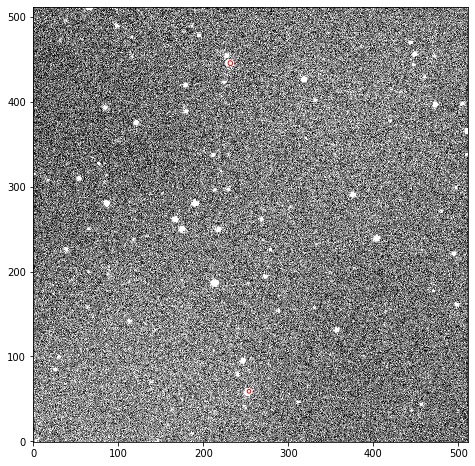

2


In [40]:
#this cell finds the two brightest stars in each image. This will be used to find out how much the image has shifted
v4041 = fitsio.read("v404cyg/v404cyg_v-001.fit")
m_stand, s_stand = np.mean(v4041), np.std(v4041)
plt.imshow(v4041, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v4041_pos = star_counter_position(v4041,v4041.max()/3-2*np.std(v4041))


v404100 = fitsio.read("v404cyg/v404cyg_v-100.fit")
m_stand, s_stand = np.mean(v404100), np.std(v404100)
plt.imshow(v404100, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v404100_pos = star_counter_position(v404100,v404100.max()/3-2*np.std(v404100))


v404200 = fitsio.read("v404cyg/v404cyg_v-200.fit")
m_stand, s_stand = np.mean(v404200), np.std(v404200)
plt.imshow(v404200, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v404200_pos = star_counter_position(v404200,v404200.max()/3-2*np.std(v404200))


v404300 = fitsio.read("v404cyg/v404cyg_v-300.fit")
m_stand, s_stand = np.mean(v404300), np.std(v404300)
plt.imshow(v404300, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v404300_pos = star_counter_position(v404300,v404300.max()/3.5-2*np.std(v404300))

v404400 = fitsio.read("v404cyg/v404cyg_v-400.fit")
m_stand, s_stand = np.mean(v404400), np.std(v404400)
plt.imshow(v404400, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v404400_pos = star_counter_position(v404400,v404400.max()/3.5-2*np.std(v404400))


v404414 = fitsio.read("v404cyg/v404cyg_v-414.fit")
m_stand, s_stand = np.mean(v404414), np.std(v404414)
plt.imshow(v404414, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
plt.show()

v404414_pos = star_counter_position(v404414,v404414.max()/3-2*np.std(v404414))

In [41]:
#defines functions that will be used below

#this plots all of the centers of the stars for the clean and normal version
def offset(v404_sum,v404414_pos):
    fig, ax = plt.subplots()
    
    for i in range(len(v404_sum)):
        e_stand = Ellipse(xy=(v404_sum['x'][i], v404_sum['y'][i]),
                    width=v404_sum['a'][i],
                    height=v404_sum['b'][i],
                    angle=v404_sum['theta'][i] * 180. / np.pi, alpha = 0.5)
        e_stand.set_facecolor('blue')
        e_stand.set_edgecolor('blue')
        ax.add_patch(e_stand)
    
    
    for i in range(len(v404414_pos)):
        e_stand = Ellipse(xy=(v404414_pos['x'][i], v404414_pos['y'][i]),
                    width=v404414_pos['a'][i],
                    height=v404414_pos['b'][i],
                    angle=v404414_pos['theta'][i] * 180. / np.pi, alpha = 0.5)
        e_stand.set_facecolor('orange')
        e_stand.set_edgecolor('orange')
        ax.add_patch(e_stand)

    plt.close()
    
    hor_shift = []
    ver_shift = []
    
    for i in range(len(v4041_pos)):
        hor_shift = v404414_pos['x'] - v404_sum['x']
        ver_shift = v404414_pos['y'] - v404_sum['y']
    print("horizontal shift in pixels",hor_shift)
    print("vertical shift in pixels",ver_shift)

    return v404_sum['x'],v404_sum['y'],v404414_pos['x'],v404414_pos['y'],hor_shift,ver_shift


#creates a dictionary with the shift in pixels
def pixel_shift(output,star_number,num_stars):
    #creates a dictionary of the shif in pixels for the two stars.
    #key 0 is star 1 and key 1 is star 2
    hor_dict = {}
    ver_dict = {}
    for j in range(num_stars):
        hor_dict[j] = []  # Initialize an empty list for each key
        ver_dict[j] = []
        for i in range(len(star_number)):
            hor_dict[j].append(output[i][-2][j])
            ver_dict[j].append(output[i][-1][j])

    return hor_dict, ver_dict

#automatically plots all the changes in pixels for each star
def pixel_plot(star_number_aug,hor_aug,ver_aug):
    for j in range(len(hor_aug)):
        plt.plot(star_number_aug,hor_aug[j], label = f"star {j+1}")
    plt.xlabel("exposure number")
    plt.ylabel("shift in pixels")
    plt.title("Horizontal shift in pixels compared to image 1")
    plt.legend()
    plt.show()
    for i in range(len(ver_aug)):
        plt.plot(star_number_aug,ver_aug[i], label = f"star {i+1}")
    plt.xlabel("exposure number")
    plt.ylabel("shift in pixels")
    plt.title("Vertical shift in pixels compared to image 1")
    plt.legend()
    plt.show()

horizontal shift in pixels [-19.52278906 -19.06094937]
vertical shift in pixels [-0.53652847 -0.73839954]
horizontal shift in pixels [-21.97240208 -21.21457001]
vertical shift in pixels [-0.59028633 -0.47287295]
horizontal shift in pixels [-21.94658034 -21.18799748]
vertical shift in pixels [-0.63129014 -0.76812564]
horizontal shift in pixels [-21.89041682 -21.21105881]
vertical shift in pixels [-1.02155499 -1.24617571]
horizontal shift in pixels [-21.27837908 -20.93681264]
vertical shift in pixels [-0.37202094 -0.63035593]


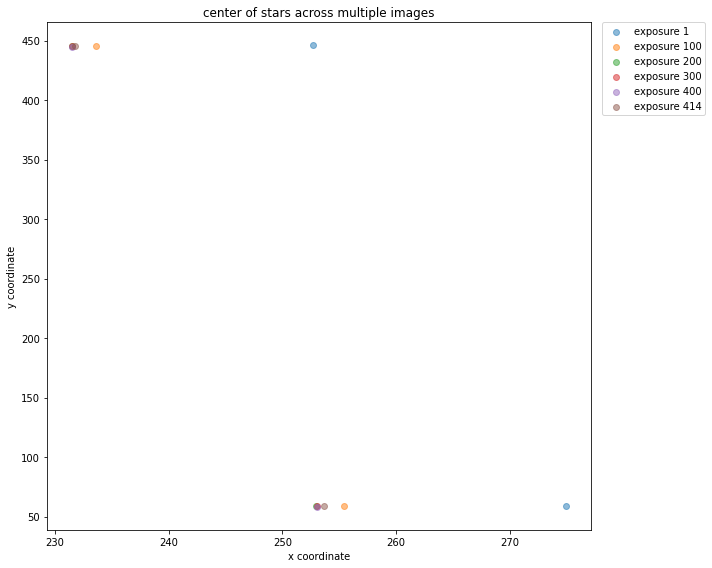

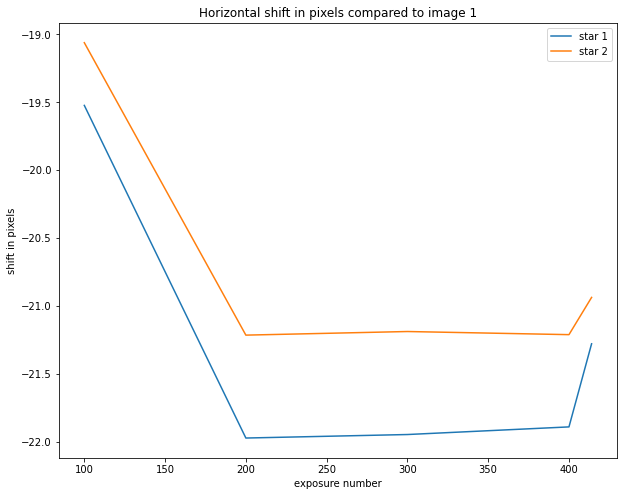

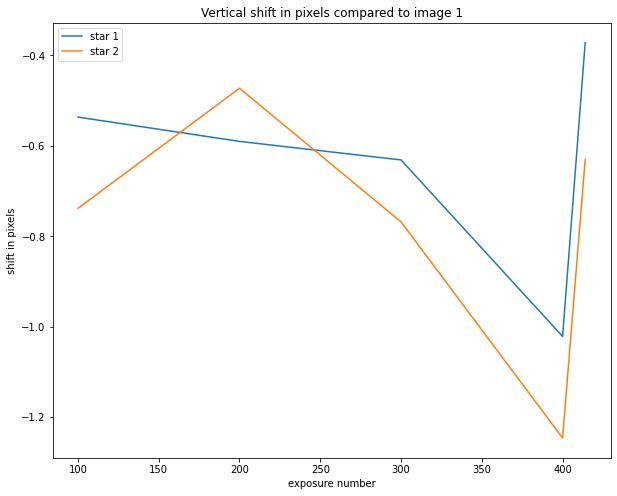

In [42]:
#this cell plots the difference in location between the center of stars across multiple images
output = []

#adds all the output from each function into one list
output.append(offset(v4041_pos,v404100_pos))
output.append(offset(v4041_pos,v404200_pos))
output.append(offset(v4041_pos,v404300_pos))
output.append(offset(v4041_pos,v404400_pos))
output.append(offset(v4041_pos,v404414_pos))

#labels the stars based on their image number
star_number = [100,200,300,400,414]
num_stars = len(output[0][0])

hor_v404, ver_v404 = pixel_shift(output,star_number,num_stars)

#plots the centers of the stars
plt.scatter(v4041_pos['x'],v4041_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(v404100_pos['x'],v404100_pos['y'], alpha = 0.5, label = "exposure 100")
plt.scatter(v404200_pos['x'],v404200_pos['y'], alpha = 0.5, label = "exposure 200")
plt.scatter(v404300_pos['x'],v404300_pos['y'], alpha = 0.5, label = "exposure 300")
plt.scatter(v404400_pos['x'],v404400_pos['y'], alpha = 0.5, label = "exposure 400")
plt.scatter(v404414_pos['x'],v404414_pos['y'], alpha = 0.5, label = "exposure 414")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.tight_layout()  # Ensures everything fits nicely
plt.savefig("star1 center")
plt.show()


pixel_plot(star_number,hor_v404,ver_v404)

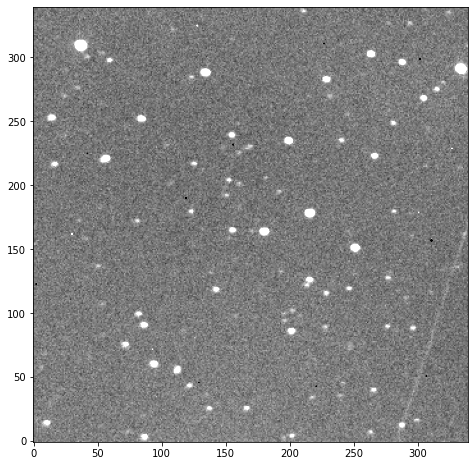

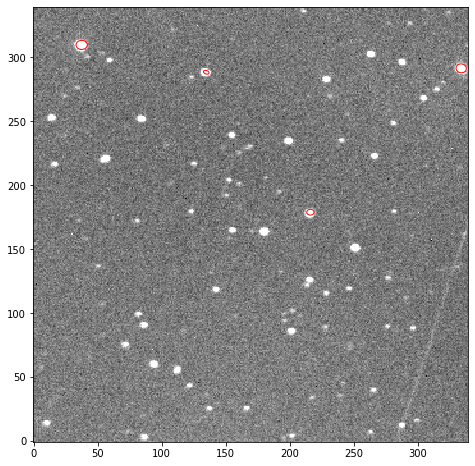

4


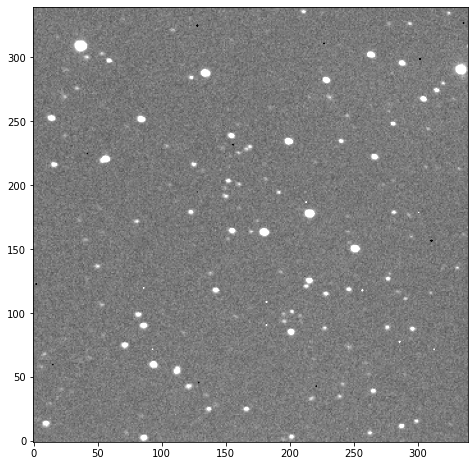

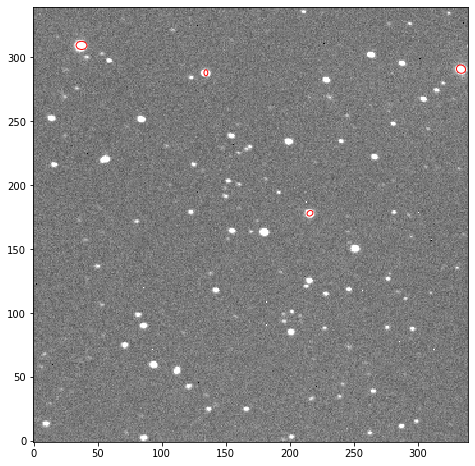

4


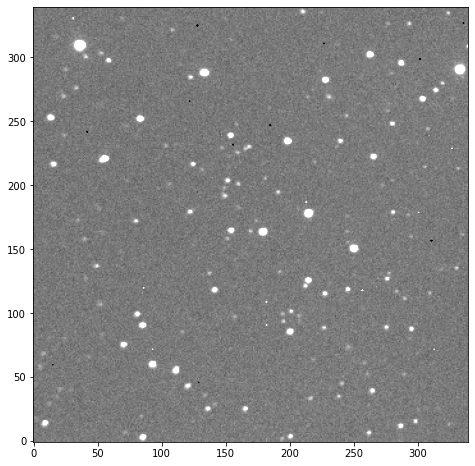

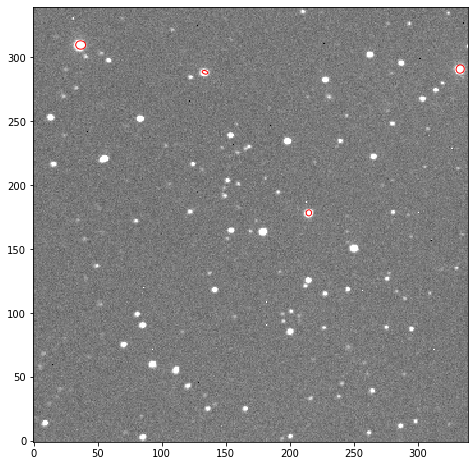

4


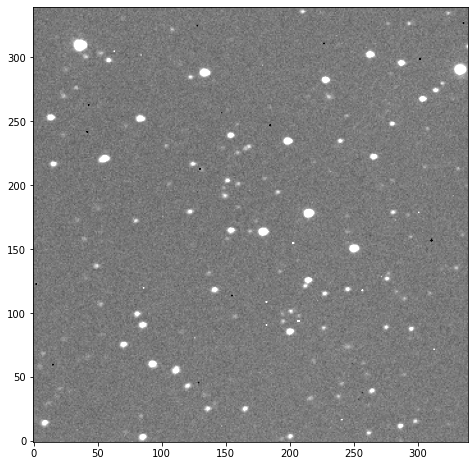

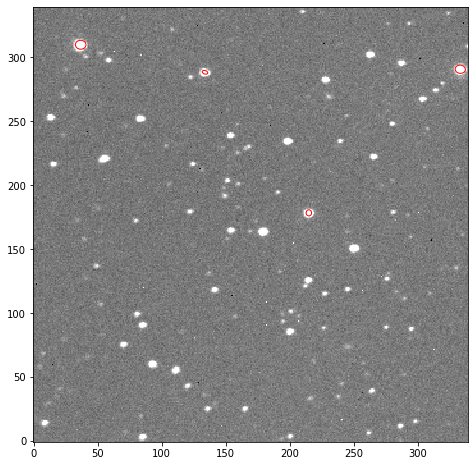

4


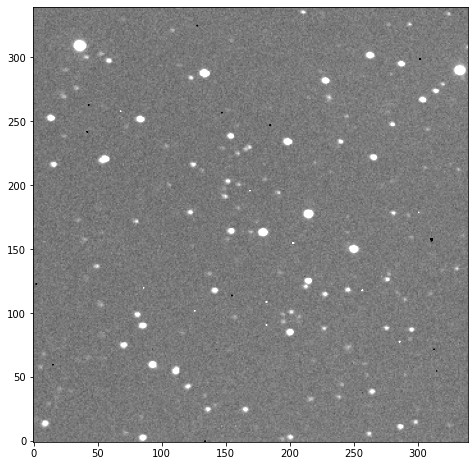

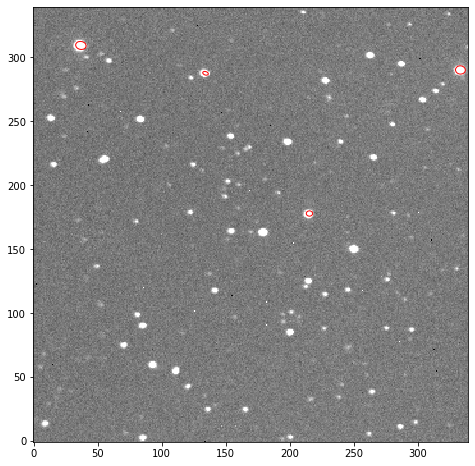

4


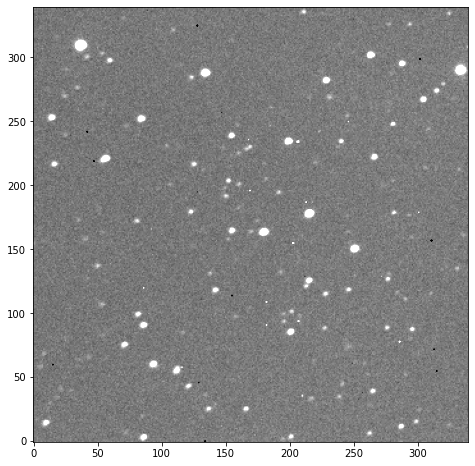

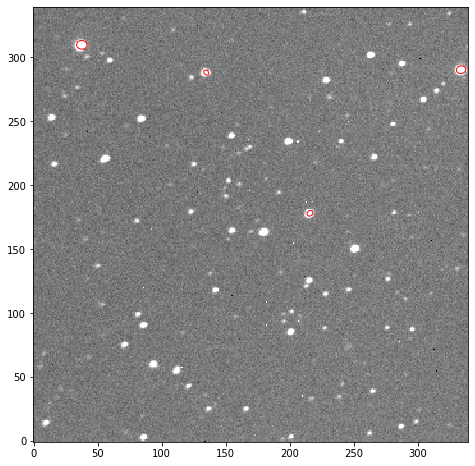

4


In [43]:
###############
#New image
###############

#this cell finds the four brightest stars in each image. This will be used to find out how much the image has shifted
aug1 = fitsio.read("aug23_2012/css2039_clear-001.fit")
aug1_sq = square_matrix(aug1)
m_stand2012, s_stand2012 = np.mean(aug1_sq), np.std(aug1_sq)
plt.imshow(aug1_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_1_pos = star_counter_position(aug1_sq,aug1_sq.max()/2.5-2*np.std(aug1_sq))


aug36 = fitsio.read("aug23_2012/css2039_clear-036.fit")
aug36_sq = square_matrix(aug36)
m_stand2012, s_stand2012 = np.mean(aug36_sq), np.std(aug36_sq)
plt.imshow(aug36_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_36_pos = star_counter_position(aug36_sq,aug36_sq.max()/3-2*np.std(aug36_sq))


aug72 = fitsio.read("aug23_2012/css2039_clear-072.fit")
aug72_sq = square_matrix(aug72)
m_stand2012, s_stand2012 = np.mean(aug72_sq), np.std(aug72_sq)
plt.imshow(aug72_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_72_pos = star_counter_position(aug72_sq,aug72_sq.max()/3-2*np.std(aug72_sq))


aug108 = fitsio.read("aug23_2012/css2039_clear-108.fit")
aug108_sq = square_matrix(aug108)
m_stand2012, s_stand2012 = np.mean(aug108_sq), np.std(aug108_sq)
plt.imshow(aug108_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_108_pos = star_counter_position(aug108_sq,aug108_sq.max()/3.35-2*np.std(aug108_sq))


aug144 = fitsio.read("aug23_2012/css2039_clear-144.fit")
aug144_sq = square_matrix(aug144)
m_stand2012, s_stand2012 = np.mean(aug144_sq), np.std(aug144_sq)
plt.imshow(aug144_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_144_pos = star_counter_position(aug144_sq,aug144_sq.max()/3.3-2*np.std(aug144_sq))


aug180 = fitsio.read("aug23_2012/css2039_clear-180.fit")
aug180_sq = square_matrix(aug180)
m_stand2012, s_stand2012 = np.mean(aug180_sq), np.std(aug180_sq)
plt.imshow(aug180_sq, cmap='gray', vmin=m_stand2012-s_stand2012, vmax=m_stand2012+s_stand2012, origin='lower')
plt.show()

aug_180_pos = star_counter_position(aug180_sq,aug180_sq.max()/3.5-2*np.std(aug180_sq))

horizontal shift in pixels [-0.30796345 -0.28698421 -0.15355371 -0.15953714]
vertical shift in pixels [-0.8108484  -0.41719454 -0.64578523 -0.41007492]
horizontal shift in pixels [-1.13728122 -0.96156603 -0.78078463 -0.82525443]
vertical shift in pixels [-0.49864542 -0.03065043 -0.59656066 -0.08052279]
horizontal shift in pixels [-1.17095457 -0.97399369 -0.7292763  -0.80706893]
vertical shift in pixels [-0.50065977 -0.02552248 -0.724299    0.11084709]
horizontal shift in pixels [-0.70759241 -0.56555776 -0.61293352 -0.63566335]
vertical shift in pixels [-1.01071829 -0.79661212 -1.28150519 -0.43921697]
horizontal shift in pixels [-0.32042023  0.02422721 -0.07314806  0.05842024]
vertical shift in pixels [-0.82314755 -0.23420047 -1.06962978  0.03154247]


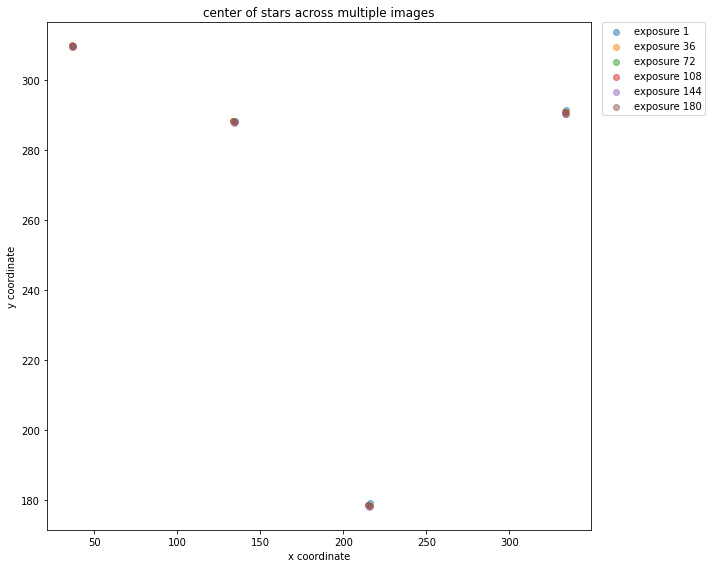

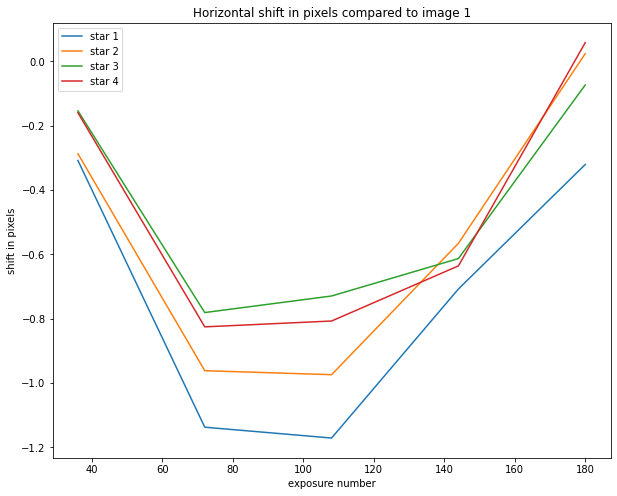

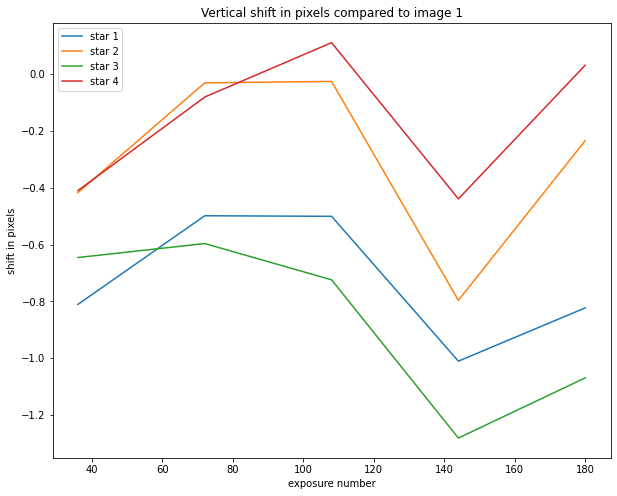

In [44]:
#this cell plots the difference in location between the center of stars across multiple images
output_aug = []


#adds all the output from each function into one list
output_aug.append(offset(aug_1_pos,aug_36_pos))
output_aug.append(offset(aug_1_pos,aug_72_pos))
output_aug.append(offset(aug_1_pos,aug_108_pos))
output_aug.append(offset(aug_1_pos,aug_144_pos))
output_aug.append(offset(aug_1_pos,aug_180_pos))

#labels the stars based on their image number
star_number_aug = [36,72,108,144,180]
num_stars_aug = len(output_aug[0][0])

hor_aug, ver_aug = pixel_shift(output_aug,star_number_aug,num_stars_aug)


#plots the centers of the stars
plt.scatter(aug_1_pos['x'],aug_1_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(aug_36_pos['x'],aug_36_pos['y'], alpha = 0.5, label = "exposure 36")
plt.scatter(aug_72_pos['x'],aug_72_pos['y'], alpha = 0.5, label = "exposure 72")
plt.scatter(aug_108_pos['x'],aug_108_pos['y'], alpha = 0.5, label = "exposure 108")
plt.scatter(aug_144_pos['x'],aug_144_pos['y'], alpha = 0.5, label = "exposure 144")
plt.scatter(aug_180_pos['x'],aug_180_pos['y'], alpha = 0.5, label = "exposure 180")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.tight_layout()  # Ensures everything fits nicely
plt.savefig("star2 center")
plt.show()

pixel_plot(star_number_aug,hor_aug,ver_aug)

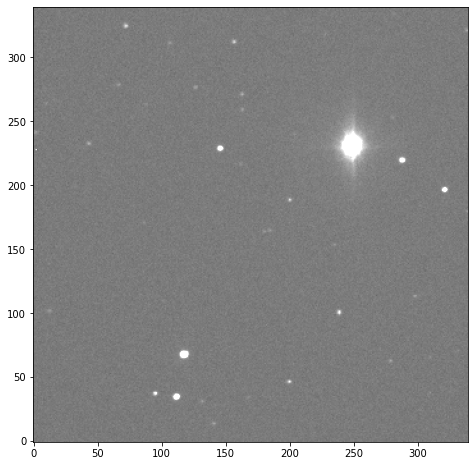

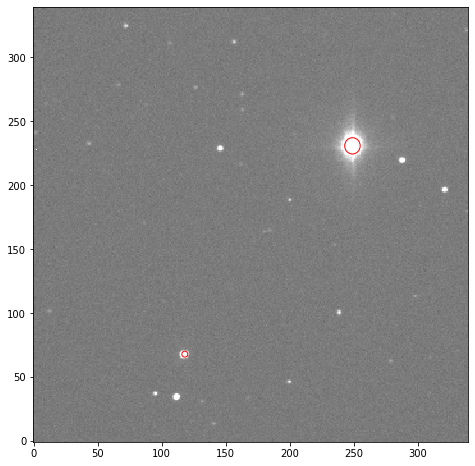

2


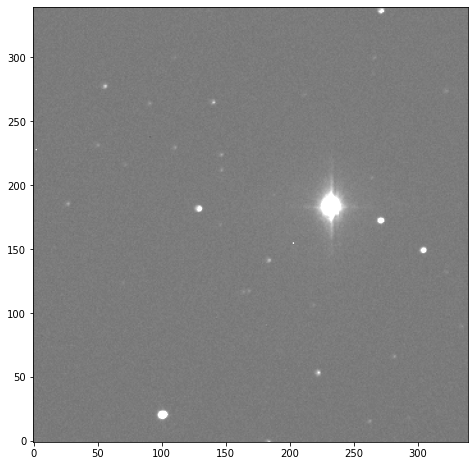

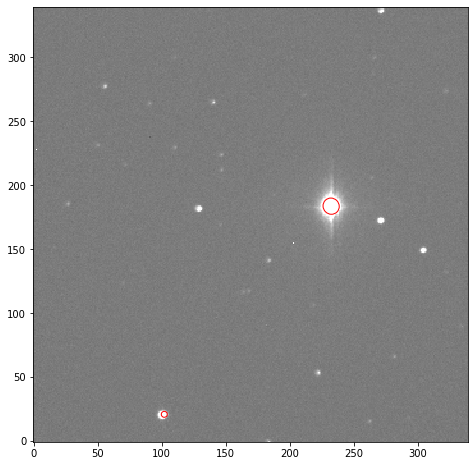

2


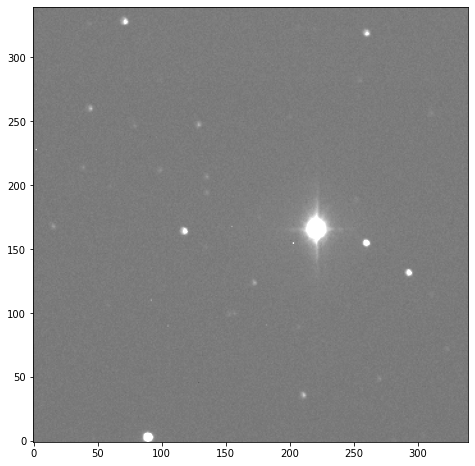

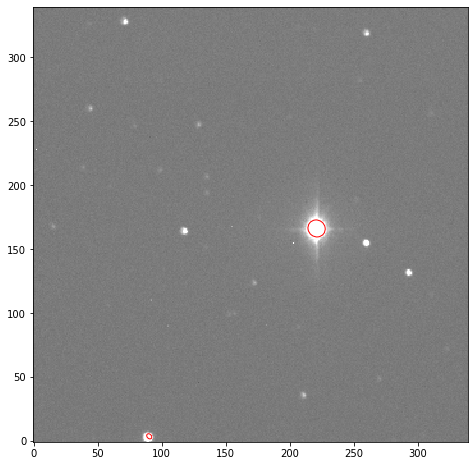

2


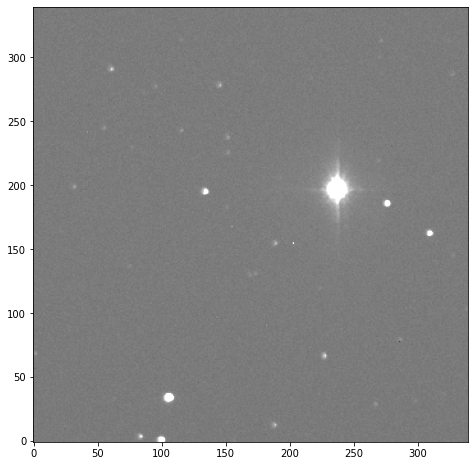

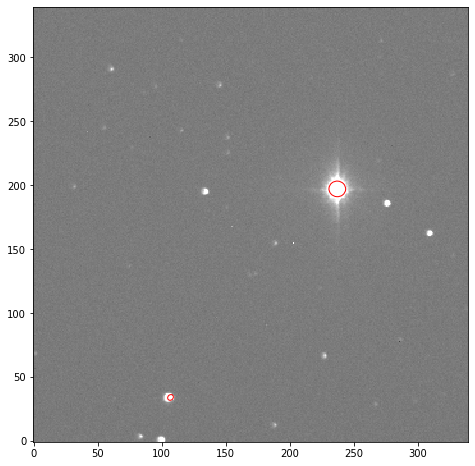

2


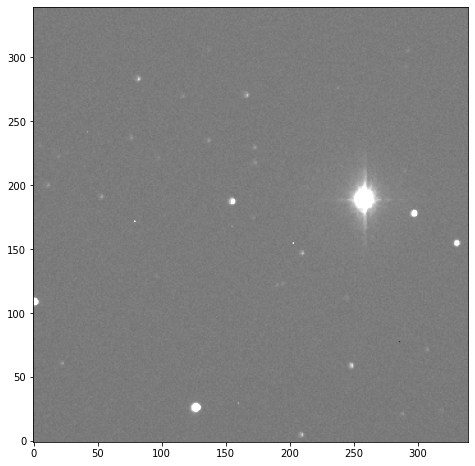

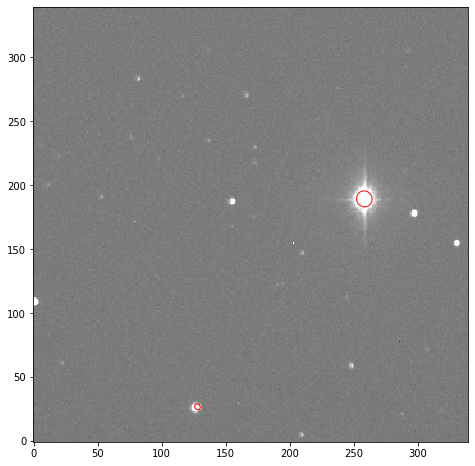

2


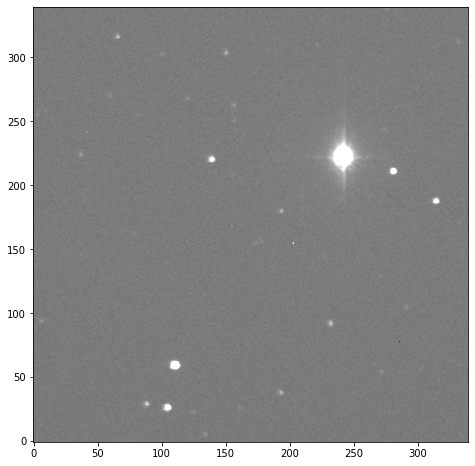

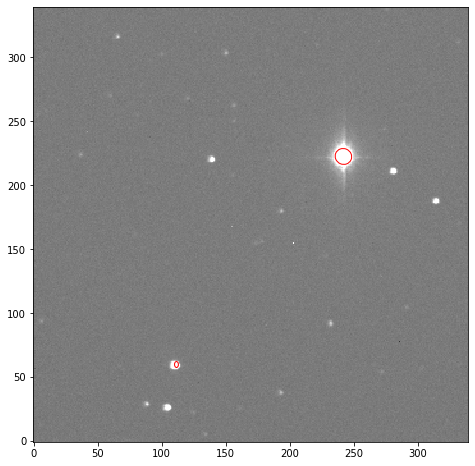

2


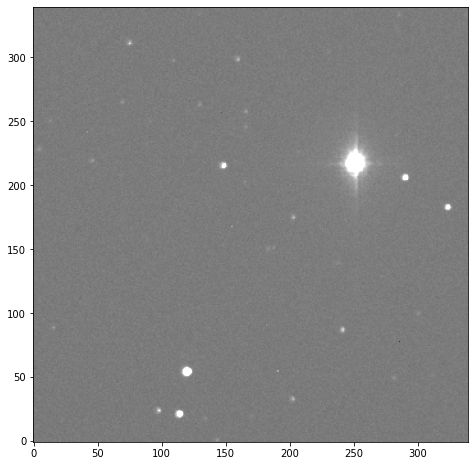

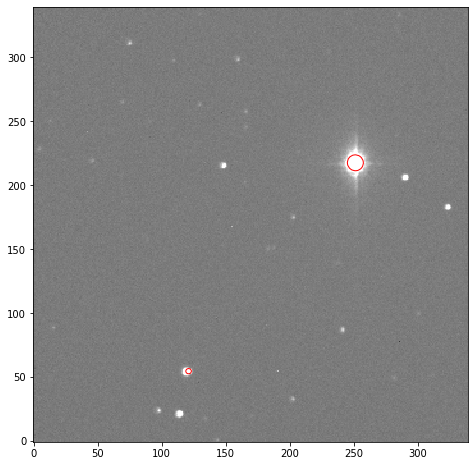

2


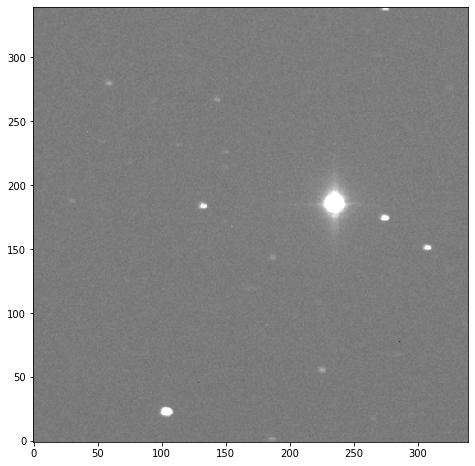

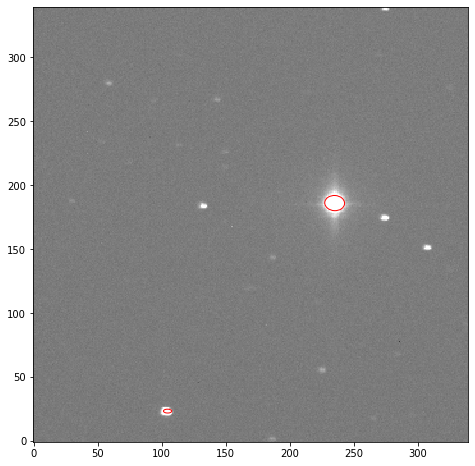

2


In [45]:
###############
#New image
###############

#this cell finds the two brightest stars in each image. This will be used to find out how much the image has shifted
jul1 = fitsio.read("jul08_2009/rxj-001.fit")
jul1_sq = square_matrix(jul1)
m_stand2009, s_stand2009 = np.mean(jul1_sq), np.std(jul1_sq)
plt.imshow(jul1_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_1_pos = star_counter_position(jul1_sq,jul1_sq.max()/4.5-2*np.std(jul1_sq))


jul100 = fitsio.read("jul08_2009/rxj-100.fit")
jul100_sq = square_matrix(jul100)
m_stand2009, s_stand2009 = np.mean(jul100_sq), np.std(jul100_sq)
plt.imshow(jul100_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_100_pos = star_counter_position(jul100_sq,jul100_sq.max()/4.5-2*np.std(jul100_sq))


jul200 = fitsio.read("jul08_2009/rxj-200.fit")
jul200_sq = square_matrix(jul200)
m_stand2009, s_stand2009 = np.mean(jul200_sq), np.std(jul200_sq)
plt.imshow(jul200_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_200_pos = star_counter_position(jul200_sq,jul200_sq.max()/4.5-2*np.std(jul200_sq))


jul300 = fitsio.read("jul08_2009/rxj-300.fit")
jul300_sq = square_matrix(jul300)
m_stand2009, s_stand2009 = np.mean(jul300_sq), np.std(jul300_sq)
plt.imshow(jul300_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_300_pos = star_counter_position(jul300_sq,jul300_sq.max()/4.5-2*np.std(jul300_sq))


jul400 = fitsio.read("jul08_2009/rxj-400.fit")
jul400_sq = square_matrix(jul400)
m_stand2009, s_stand2009 = np.mean(jul400_sq), np.std(jul400_sq)
plt.imshow(jul400_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_400_pos = star_counter_position(jul400_sq,jul400_sq.max()/4.5-2*np.std(jul400_sq))


jul500 = fitsio.read("jul08_2009/rxj-500.fit")
jul500_sq = square_matrix(jul500)
m_stand2009, s_stand2009 = np.mean(jul500_sq), np.std(jul500_sq)
plt.imshow(jul500_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_500_pos = star_counter_position(jul500_sq,jul500_sq.max()/4.5-2*np.std(jul500_sq))


jul600 = fitsio.read("jul08_2009/rxj-600.fit")
jul600_sq = square_matrix(jul600)
m_stand2009, s_stand2009 = np.mean(jul600_sq), np.std(jul600_sq)
plt.imshow(jul600_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_600_pos = star_counter_position(jul600_sq,jul600_sq.max()/4.5-2*np.std(jul600_sq))


jul643 = fitsio.read("jul08_2009/rxj-643.fit")
jul643_sq = square_matrix(jul643)
m_stand2009, s_stand2009 = np.mean(jul643_sq), np.std(jul643_sq)
plt.imshow(jul643_sq, cmap='gray', vmin=m_stand2009-s_stand2009, vmax=m_stand2009+s_stand2009, origin='lower')
plt.show()

jul_643_pos = star_counter_position(jul643_sq,jul643_sq.max()/5.5-2*np.std(jul643_sq))


horizontal shift in pixels [-16.06409142 -16.65744356]
vertical shift in pixels [-47.05135581 -47.15342108]
horizontal shift in pixels [-27.79974822 -28.03499987]
vertical shift in pixels [-64.25171445 -64.5713842 ]
horizontal shift in pixels [-11.17366622 -11.83771112]
vertical shift in pixels [-33.84708211 -33.65414202]
horizontal shift in pixels [9.85457718 9.27765308]
vertical shift in pixels [-41.16732486 -41.45134274]
horizontal shift in pixels [-6.51972485 -7.05461456]
vertical shift in pixels [-8.11005962 -8.29183254]
horizontal shift in pixels [2.96207575 2.28727809]
vertical shift in pixels [-13.31392614 -13.24569182]
horizontal shift in pixels [-13.46479183 -13.8993757 ]
vertical shift in pixels [-44.54146114 -44.74005038]


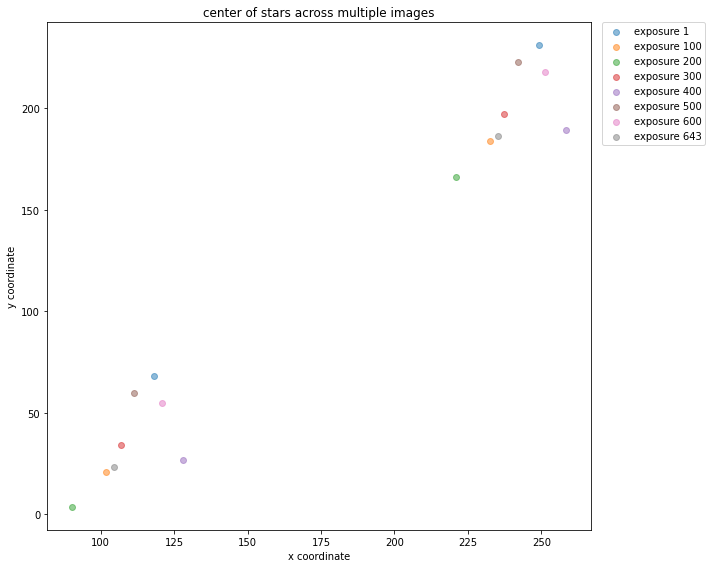

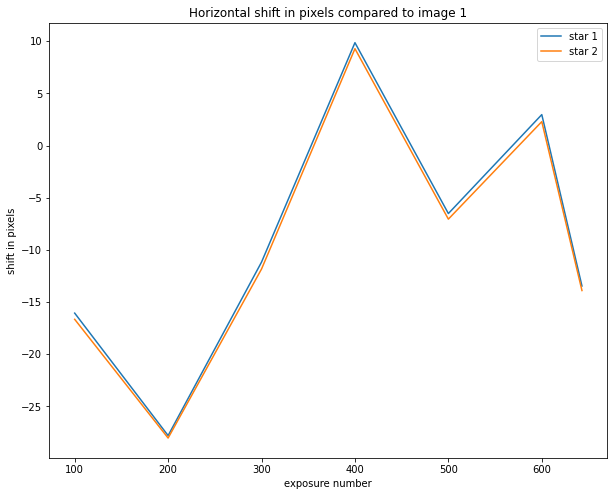

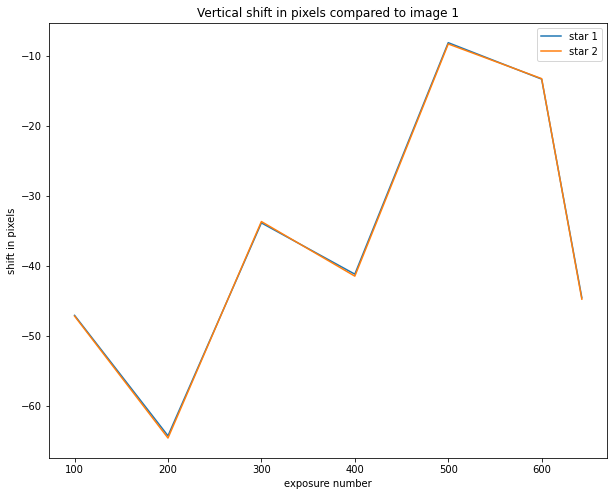

In [46]:
#this cell plots the difference in location between the center of stars across multiple images
output_jul = []


#adds all the output from each function into one list
output_jul.append(offset(jul_1_pos,jul_100_pos))
output_jul.append(offset(jul_1_pos,jul_200_pos))
output_jul.append(offset(jul_1_pos,jul_300_pos))
output_jul.append(offset(jul_1_pos,jul_400_pos))
output_jul.append(offset(jul_1_pos,jul_500_pos))
output_jul.append(offset(jul_1_pos,jul_600_pos))
output_jul.append(offset(jul_1_pos,jul_643_pos))

#labels the stars based on their image number
star_number_jul = [100,200,300,400,500,600,643]
num_stars_jul = len(output_jul[0][0])

hor_jul, ver_jul = pixel_shift(output_jul,star_number_jul,num_stars_jul)


#plots the centers of the stars
plt.scatter(jul_1_pos['x'],jul_1_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(jul_100_pos['x'],jul_100_pos['y'], alpha = 0.5, label = "exposure 100")
plt.scatter(jul_200_pos['x'],jul_200_pos['y'], alpha = 0.5, label = "exposure 200")
plt.scatter(jul_300_pos['x'],jul_300_pos['y'], alpha = 0.5, label = "exposure 300")
plt.scatter(jul_400_pos['x'],jul_400_pos['y'], alpha = 0.5, label = "exposure 400")
plt.scatter(jul_500_pos['x'],jul_500_pos['y'], alpha = 0.5, label = "exposure 500")
plt.scatter(jul_600_pos['x'],jul_600_pos['y'], alpha = 0.5, label = "exposure 600")
plt.scatter(jul_643_pos['x'],jul_643_pos['y'], alpha = 0.5, label = "exposure 643")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.tight_layout()  # Ensures everything fits nicely
plt.savefig("star3 center")
plt.show()

pixel_plot(star_number_jul,hor_jul,ver_jul)

<span style="font-size: 18pt;">The below section involves moving the images back into place.</span>


In [47]:
def resize(v4041,shift_y_top,shift_y_bottom,shift_x_left,shift_x_right):
    #shift_x_right means is chops off the right side
    #this chops off the beginning and the end of the image by a specified amount in the x and y dierctions
    test = []
    for i in range(shift_y_bottom,len(v4041)-shift_y_top):
        test_placeholder = []
        for j in range(shift_x_left,len(v4041)-shift_x_right):   
            test_placeholder.append(v4041[i][j])
        test.append(test_placeholder)

    test = np.array(test)

    return test

#negative change in pixels should be shifted right
def shift_right(v404414,test_right,difference): 
    difference = round(difference)
    
    #defines a matrix full of zeros to be filled with values from the image (the leftover values will still be zero)
    matrix_zero = []
    v404414_right = []
    placeholder = len(v404414)*[0]
    for j in range(len(v404414)):
        matrix_zero.append(placeholder)
    
    #chops off the right side of the image and replaces it with zeros
    for i in range(len(test_right)):
        for j in range(len(test_right[i])):
            matrix_zero[i][j] = test_right[i][j]
        v404414_right.append(matrix_zero[i].copy())

    #plots the image with the right side chopped off 
    #m_stand, s_stand = np.mean(v404414_right), np.std(v404414_right)
    #plt.imshow(v404414_right, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
      
    
    #shifts the matrix to the right as many columns as were chopped off
    shifted_matrix = []
    for i in range(len(v404414_right)):
        placeholder_shift = []
        for j in range(len(v404414_right)):
            placeholder_shift.append(v404414_right[i][int((j+difference)%len(v404414))])
        shifted_matrix.append(placeholder_shift)
    
    #plots the final image
    #m_stand, s_stand = np.mean(shifted_matrix), np.std(shifted_matrix)
    #plt.imshow(shifted_matrix, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()

    return shifted_matrix

#positive shift in pixels should be shifted left
def shift_left(v404414,test_left,difference): 
    difference = round(difference)
    
    #defines a matrix full of zeros to be filled with values from the image (the leftover values will still be zero)
    matrix_zero = []
    v404414_left = []
    placeholder = len(v404414)*[0]
    for j in range(len(v404414)):
        matrix_zero.append(placeholder)
    
    #chops off the left side of the image and replaces it with zeros
    for i in range(len(test_left)): #the -1 is to avoid rounding 
        for j in range(difference,len(v404414)-1):
            matrix_zero[i][j] = test_left[i][(j-difference)]
        v404414_left.append(matrix_zero[i].copy())

    #plots the image with the left side chopped off 
    #m_stand, s_stand = np.mean(v404414_left), np.std(v404414_left)
    #plt.imshow(v404414_left, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
      
    
    #shifts the matrix to the left as many columns as were chopped off
    shifted_matrix = []
    for i in range(len(v404414_left)):
        placeholder_shift = []
        for j in range(len(v404414_left)):
            placeholder_shift.append(v404414_left[i][int((j+difference)%len(v404414))])
        shifted_matrix.append(placeholder_shift)

        
    #plots the final image
    #m_stand, s_stand = np.mean(shifted_matrix), np.std(shifted_matrix)
    #plt.imshow(shifted_matrix, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()

    return shifted_matrix

#negative shift in pixels should be shifted up
def shift_up(v404414,difference):
    difference = abs(round(difference))
        
    #rotates the matrix 90 degrees CCW
    tp = list(zip(*v404414[::-1]))

    #chops off the right side of the rotated image
    test_up = resize(tp,0,0,difference,0)

    #plots the rotated images with the right side chopped off
    #m_stand, s_stand = np.mean(test_up), np.std(test_up)
    #plt.imshow(test_up, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
    
    #shifts the image to the left
    left = shift_left(v404414,test_up,difference)

    #rotates the image back to its original position
    rotated = list(reversed(list(zip(*left))))
    
    #m_stand, s_stand = np.mean(rotated), np.std(rotated)
    #plt.imshow(rotated, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
    
    return rotated

#positive shift in pixels should be shifted down
def shift_down(v404414,difference):
    difference = abs(round(difference))
        
    #rotates the matrix 90 degrees CW
    tp = list(reversed(list(zip(*v404414))))

    #chops off the right side of the rotated image
    test_up = resize(tp,0,0,difference,0)

    #plots the rotated images with the right side chopped off
    #m_stand, s_stand = np.mean(test_up), np.std(test_up)
    #plt.imshow(test_up, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
    
    #shifts the image to the left
    left = shift_left(v404414,test_up,difference)

    #rotates the image back to its original position
    rotated = list(zip(*left[::-1]))
    
    #m_stand, s_stand = np.mean(rotated), np.std(rotated)
    #plt.imshow(rotated, cmap='gray', vmin=m_stand-s_stand, vmax=m_stand+s_stand, origin='lower')
    #plt.show()
    
    return rotated

#displays the new image after is has been shifted in the x and y directions
def star_shift_counter(v404414,hor_v4041,hor_v4042,ver_v4041,ver_v4042,factor):
    #averaging the change in each direction
    v404_x_dif = (hor_v4041 + hor_v4042)/2
    v404_y_dif = (ver_v4041 + ver_v4042)/2

    if(v404_x_dif <= 0 ):
        #chop off the appropriate number of columns
        v404_right = resize(v404414,0,0,0,-int(v404_x_dif))
    
        #shift the image over in both directions
        shifted_right = shift_right(v404414,v404_right,v404_x_dif)
        if(v404_x_dif <= 0 ):
            v404_shifted = shift_up(shifted_right,-v404_y_dif)
        else:
            v404_shifted = shift_up(shifted_right,v404_y_dif)
        #turn it back into a numpy array so the stars' positions can be found
        v404_shifted = np.array(v404_shifted)
    
        #stors and displays the new positions of the stars
        v404414_pos_correct = star_counter_position(v404_shifted,v404_shifted.max()/factor-2*np.std(v404_shifted))

    else:
        #chop off the appropriate number of columns
        v404_right = resize(v404414,0,0,int(v404_x_dif),0)
    
        #shift the image over in both directions
        shifted_right = shift_left(v404414,v404_right,v404_x_dif)
        v404_shifted = shift_up(shifted_right,v404_y_dif)
    
        #turn it back into a numpy array so the stars' positions can be found
        v404_shifted = np.array(v404_shifted)
    
        #stors and displays the new positions of the stars
        v404414_pos_correct = star_counter_position(v404_shifted,v404_shifted.max()/factor-2*np.std(v404_shifted))
    
    return v404414_pos_correct, v404_shifted

def star_shift_counter2(v404414,hor_v4041,hor_v4042,ver_v4041,ver_v4042,factor):
    #averaging the change in each direction
    v404_x_dif = (hor_v4041 + hor_v4042)/2
    v404_y_dif = (ver_v4041 + ver_v4042)/2

    if(v404_x_dif <= 0 ):
        #chop off the appropriate number of columns
        v404_right = resize(v404414,0,0,0,-int(v404_x_dif))
    
        #shift the image over in both directions
        shifted_right = shift_right(v404414,v404_right,v404_x_dif)
        if(v404_y_dif <= 0 ):
            v404_shifted = shift_up(shifted_right,-v404_y_dif)
        else:
            v404_shifted = shift_up(shifted_right,v404_y_dif)
        #turn it back into a numpy array so the stars' positions can be found
        v404_shifted = np.array(v404_shifted)
    
        #stors and displays the new positions of the stars
        v404414_pos_correct = star_counter_position(v404_shifted,v404_shifted.max()/factor-2*np.std(v404_shifted))

    else:
        #chop off the appropriate number of columns
        v404_right = resize(v404414,0,0,int(v404_x_dif),0)
    
        #shift the image over in both directions
        shifted_right = shift_left(v404414,v404_right,v404_x_dif)
        if(v404_y_dif >= 0 ):
            v404_shifted = shift_up(shifted_right,-v404_y_dif)
        else:
            v404_shifted = shift_up(shifted_right,v404_y_dif)
    
        #turn it back into a numpy array so the stars' positions can be found
        v404_shifted = np.array(v404_shifted)
    
        #stors and displays the new positions of the stars
        v404414_pos_correct = star_counter_position(v404_shifted,v404_shifted.max()/factor-2*np.std(v404_shifted))
    
    return v404414_pos_correct

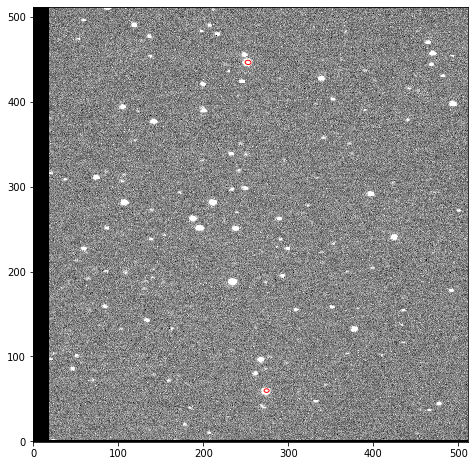

2


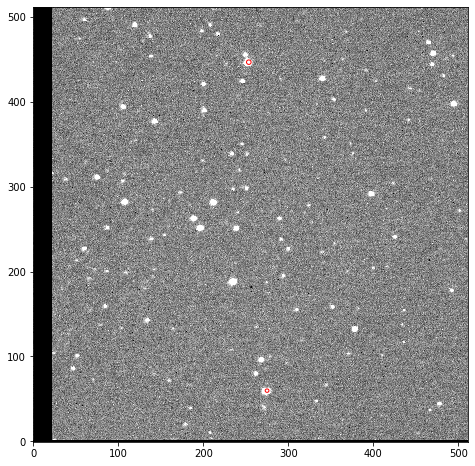

2


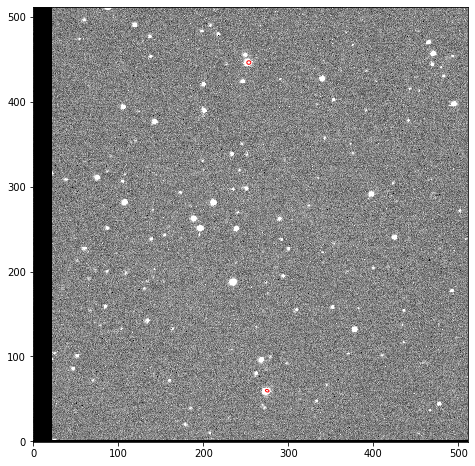

2


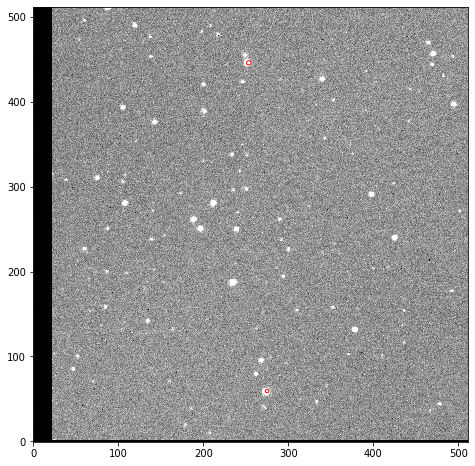

2


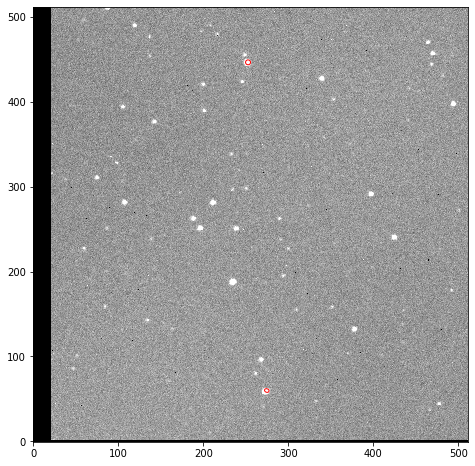

2


In [48]:
#shifts the v404 images back into place and counts their two brightest stars
v404100_pos_correct, v404100_shift = star_shift_counter(v404100,hor_v404[0][0],hor_v404[1][0],ver_v404[0][0],ver_v404[1][0],3)
v404200_pos_correct, v404200_shift = star_shift_counter(v404200,hor_v404[0][1],hor_v404[1][1],ver_v404[0][1],ver_v404[1][1],3)
v404300_pos_correct, v404300_shift = star_shift_counter(v404300,hor_v404[0][2],hor_v404[1][2],ver_v404[0][2],ver_v404[1][2],3)
v404400_pos_correct, v404400_shift = star_shift_counter(v404400,hor_v404[0][-2],hor_v404[1][-2],ver_v404[0][-2],ver_v404[1][-2],3.45)
v404414_pos_correct, v404414_shift = star_shift_counter(v404414,hor_v404[0][-1],hor_v404[1][-1],ver_v404[0][-1],ver_v404[1][-1],3)

horizontal shift in pixels [-0.52278906 -0.06094937]
vertical shift in pixels [0.46347153 0.26160046]
horizontal shift in pixels [0.02759792 0.78542999]
vertical shift in pixels [0.40971367 0.52712705]
horizontal shift in pixels [0.22445814 0.81095837]
vertical shift in pixels [0.29119014 0.10418239]
horizontal shift in pixels [0.10958318 0.78894119]
vertical shift in pixels [-0.02155499 -0.24617571]
horizontal shift in pixels [-0.31518188 -0.1106098 ]
vertical shift in pixels [0.5498628  0.34543187]


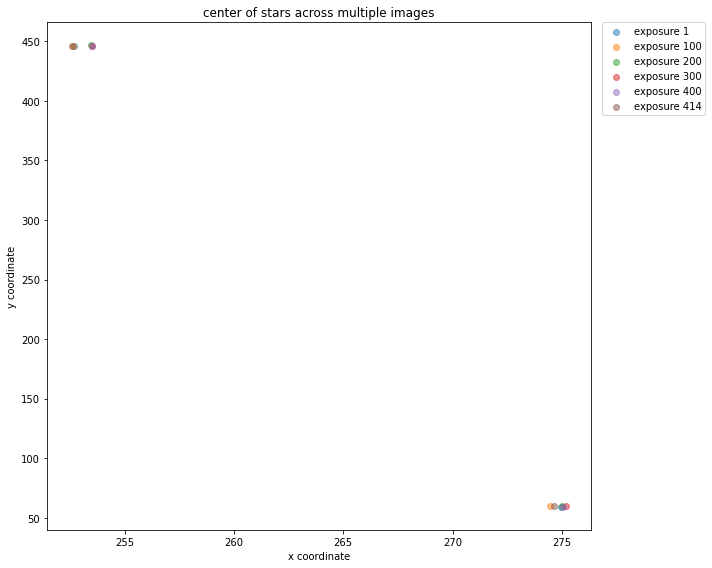

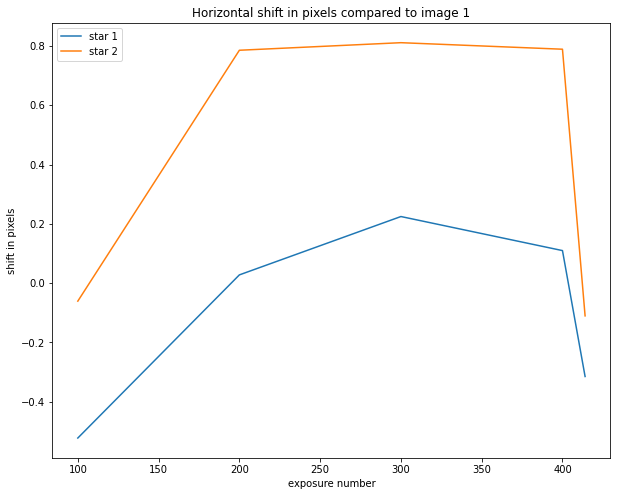

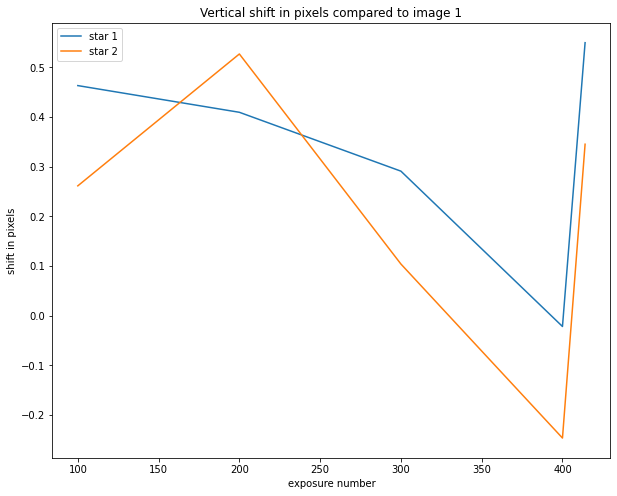

In [49]:
#plots the corrected images to see how much their values change

output_v404_shift = []


#adds all the output from each function into one list
output_v404_shift.append(offset(v4041_pos,v404100_pos_correct))
output_v404_shift.append(offset(v4041_pos,v404200_pos_correct))
output_v404_shift.append(offset(v4041_pos,v404300_pos_correct))
output_v404_shift.append(offset(v4041_pos,v404400_pos_correct))
output_v404_shift.append(offset(v4041_pos,v404414_pos_correct))

#labels the stars based on their image number
star_number_v404_correct = [100,200,300,400,414]
num_stars_v404_shift = len(output_v404_shift[0][0])

hor_v404_new, ver_v404_new = pixel_shift(output_v404_shift,star_number_v404_correct,num_stars_v404_shift)

plt.scatter(v4041_pos['x'],v4041_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(v404100_pos_correct['x'],v404100_pos_correct['y'], alpha = 0.5, label = "exposure 100")
plt.scatter(v404200_pos_correct['x'],v404200_pos_correct['y'], alpha = 0.5, label = "exposure 200")
plt.scatter(v404300_pos_correct['x'],v404300_pos_correct['y'], alpha = 0.5, label = "exposure 300")
plt.scatter(v404400_pos_correct['x'],v404400_pos_correct['y'], alpha = 0.5, label = "exposure 400")
plt.scatter(v404414_pos_correct['x'],v404414_pos_correct['y'], alpha = 0.5, label = "exposure 414")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.tight_layout()  # Ensures everything fits nicely
plt.savefig("star1 center fixed")
plt.show()

pixel_plot(star_number_v404_correct ,hor_v404_new,ver_v404_new)

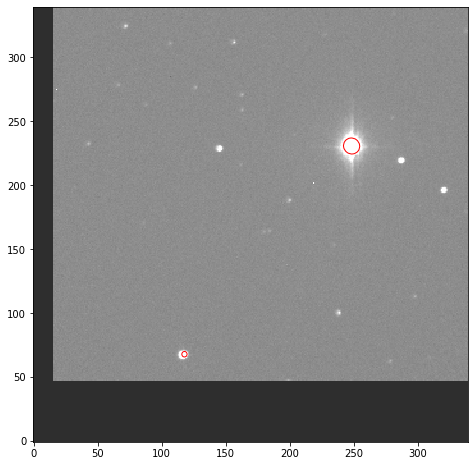

2


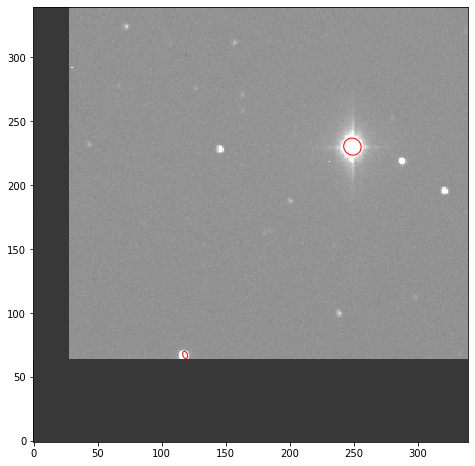

2


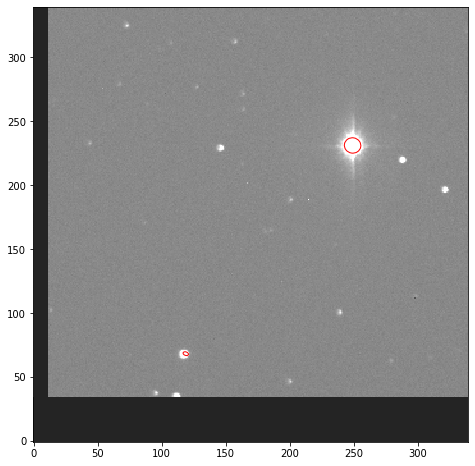

2


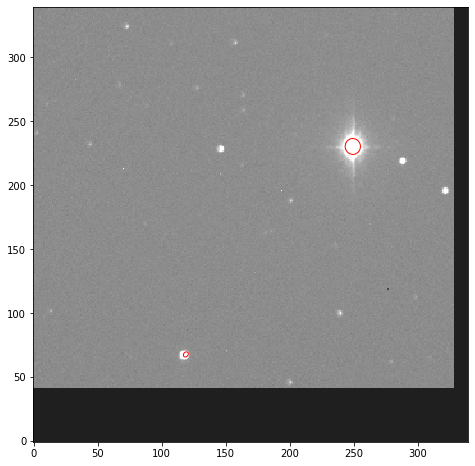

2


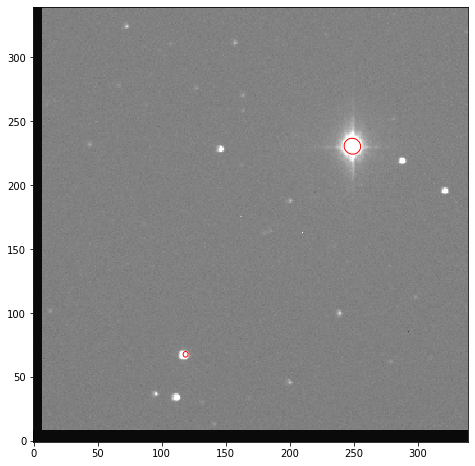

2


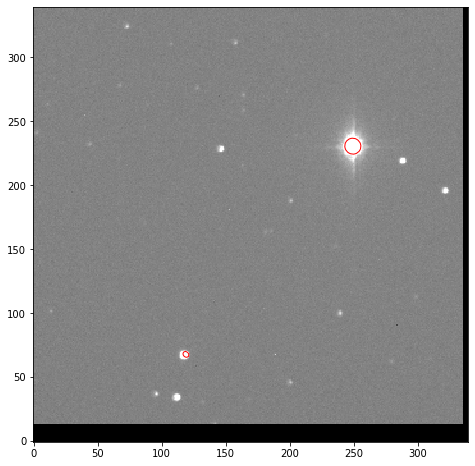

2


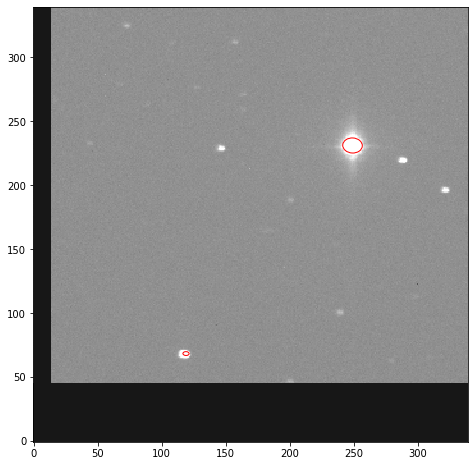

2


In [50]:
#shifts the Jul2009 images back into place and counts their two brightest stars

jul100_pos_correct, jul100_shift  = star_shift_counter(jul100_sq,hor_jul[0][0],hor_jul[1][0],ver_jul[0][0],ver_jul[1][0],4)
jul200_pos_correct, jul200_shift = star_shift_counter(jul200_sq,hor_jul[0][1],hor_jul[1][1],ver_jul[0][1],ver_jul[1][1],4.7)
jul300_pos_correct, jul300_shift = star_shift_counter(jul300_sq,hor_jul[0][2],hor_jul[1][2],ver_jul[0][2],ver_jul[1][2],4)
jul400_pos_correct, jul400_shift = star_shift_counter(jul400_sq,hor_jul[0][3],hor_jul[1][3],ver_jul[0][3],ver_jul[1][3],4)
jul500_pos_correct, jul500_shift = star_shift_counter(jul500_sq,hor_jul[0][4],hor_jul[1][4],ver_jul[0][4],ver_jul[1][4],4.7)
jul600_pos_correct, jul600_shift = star_shift_counter(jul600_sq,hor_jul[0][5],hor_jul[1][5],ver_jul[0][5],ver_jul[1][5],4.7)
jul643_pos_correct, jul643_shift = star_shift_counter(jul643_sq,hor_jul[0][6],hor_jul[1][6],ver_jul[0][6],ver_jul[1][6],4.7)

horizontal shift in pixels [-0.26951294 -0.66036292]
vertical shift in pixels [-0.04862063 -0.10944796]
horizontal shift in pixels [ 0.25056929 -0.04200502]
vertical shift in pixels [-0.59222369 -0.58976941]
horizontal shift in pixels [0.75522212 0.11563446]
vertical shift in pixels [0.37411892 0.30510648]
horizontal shift in pixels [0.82181642 0.2831236 ]
vertical shift in pixels [-0.19942154 -0.47645122]
horizontal shift in pixels [ 0.64101975 -0.05461456]
vertical shift in pixels [-0.10179955 -0.29183254]
horizontal shift in pixels [0.8652012  0.30536361]
vertical shift in pixels [-0.1889601  -0.25208423]
horizontal shift in pixels [0.94791656 0.0643164 ]
vertical shift in pixels [0.45554081 0.28819716]


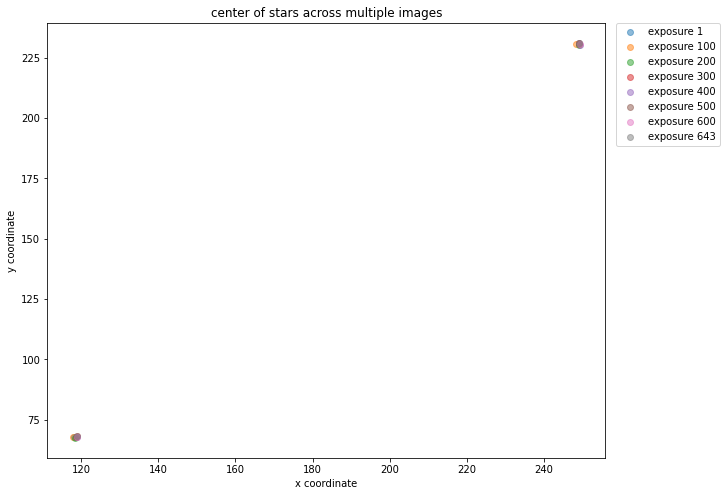

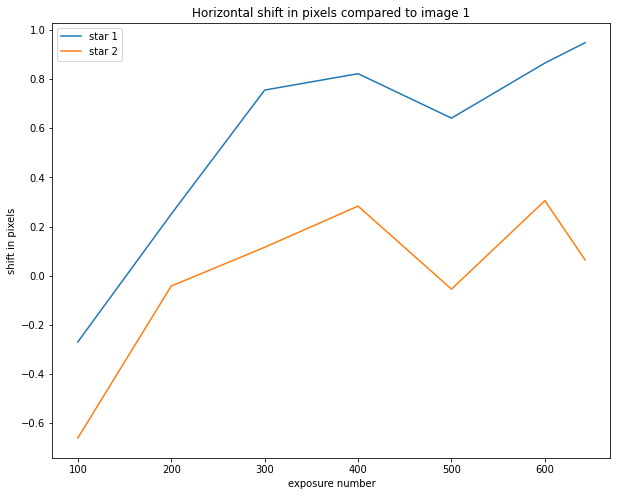

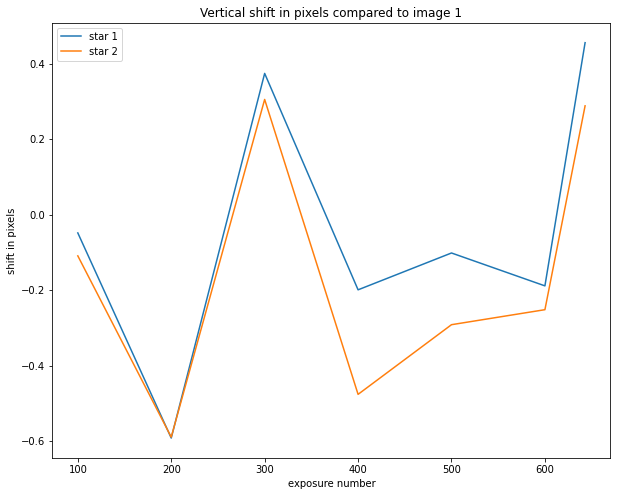

In [51]:
#plots the corrected images to see how much their values change

output_jul_shift = []


#adds all the output from each function into one list
output_jul_shift.append(offset(jul_1_pos,jul100_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul200_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul300_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul400_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul500_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul600_pos_correct))
output_jul_shift.append(offset(jul_1_pos,jul643_pos_correct))

#labels the stars based on their image number
star_number_jul_correct = [100,200,300,400,500,600,643]
num_stars_jul_shift = len(output_jul_shift[0][0])

hor_jul_new, ver_jul_new = pixel_shift(output_jul_shift,star_number_jul_correct,num_stars_jul_shift)

plt.scatter(jul_1_pos['x'],jul_1_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(jul100_pos_correct['x'],jul100_pos_correct['y'], alpha = 0.5, label = "exposure 100")
plt.scatter(jul200_pos_correct['x'],jul200_pos_correct['y'], alpha = 0.5, label = "exposure 200")
plt.scatter(jul300_pos_correct['x'],jul300_pos_correct['y'], alpha = 0.5, label = "exposure 300")
plt.scatter(jul400_pos_correct['x'],jul400_pos_correct['y'], alpha = 0.5, label = "exposure 400")
plt.scatter(jul500_pos_correct['x'],jul500_pos_correct['y'], alpha = 0.5, label = "exposure 500")
plt.scatter(jul600_pos_correct['x'],jul600_pos_correct['y'], alpha = 0.5, label = "exposure 600")
plt.scatter(jul643_pos_correct['x'],jul643_pos_correct['y'], alpha = 0.5, label = "exposure 643")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.show()

pixel_plot(star_number_jul_correct ,hor_jul_new,ver_jul_new)

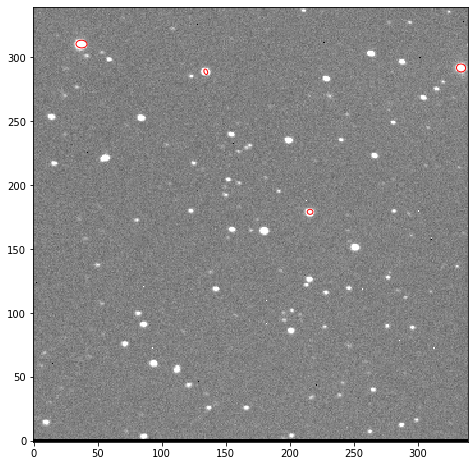

4


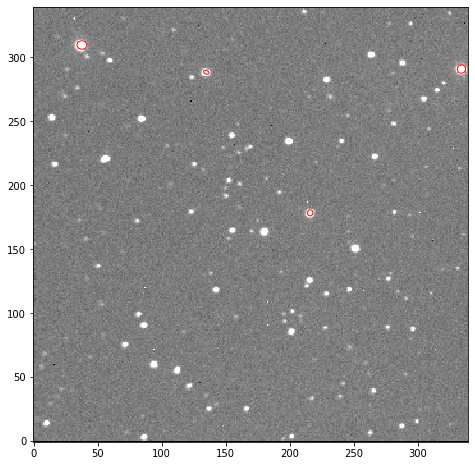

4


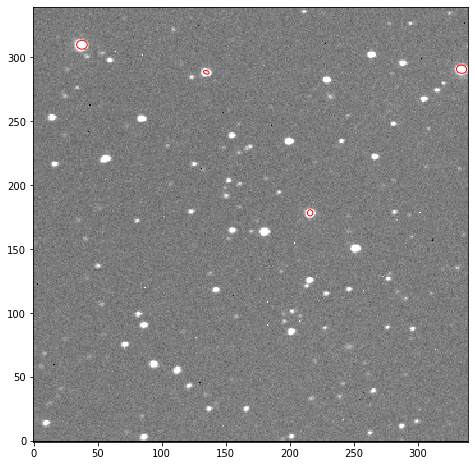

4


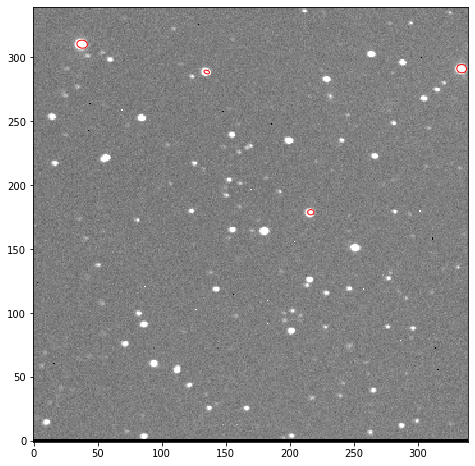

4


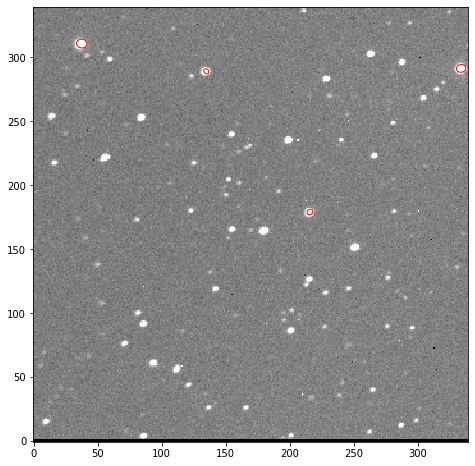

4


In [52]:
#shifts the aug2012 images back into place and counts their four brightest stars

#these average the difference in position for two stars at a time
#since the funcitno only takes two values for the difference in position as inputs 
hor_aug0_1 = (hor_aug[0][0] + hor_aug[1][0])/2
hor_aug0_2 = (hor_aug[2][0] + hor_aug[3][0])/2
ver_aug0_1 = (ver_aug[0][0] + ver_aug[1][0])/2
ver_aug0_2 = (ver_aug[2][0] + ver_aug[3][0])/2

hor_aug1_1 = (hor_aug[0][1] + hor_aug[1][1])/2
hor_aug1_2 = (hor_aug[2][1] + hor_aug[3][1])/2
ver_aug1_1 = (ver_aug[0][1] + ver_aug[1][1])/2
ver_aug1_2 = (ver_aug[2][1] + ver_aug[3][1])/2

hor_aug2_1 = (hor_aug[0][2] + hor_aug[1][2])/2
hor_aug2_2 = (hor_aug[2][2] + hor_aug[3][2])/2
ver_aug2_1 = (ver_aug[0][2] + ver_aug[1][2])/2
ver_aug2_2 = (ver_aug[2][2] + ver_aug[3][2])/2

hor_aug3_1 = (hor_aug[0][3] + hor_aug[1][3])/2
hor_aug3_2 = (hor_aug[2][3] + hor_aug[3][3])/2
ver_aug3_1 = (ver_aug[0][3] + ver_aug[1][3])/2
ver_aug3_2 = (ver_aug[2][3] + ver_aug[3][3])/2

hor_aug4_1 = (hor_aug[0][4] + hor_aug[1][4])/2
hor_aug4_2 = (hor_aug[2][4] + hor_aug[3][4])/2
ver_aug4_1 = (ver_aug[0][4] + ver_aug[1][4])/2
ver_aug4_2 = (ver_aug[2][4] + ver_aug[3][4])/2


aug36_pos_correct, aug36_shift = star_shift_counter(aug36_sq,hor_aug0_1,hor_aug0_2,ver_aug0_1,ver_aug0_2,2.75)
aug72_pos_correct, aug72_shift = star_shift_counter(aug72_sq,hor_aug1_1,hor_aug1_2,ver_aug1_1,ver_aug1_2,3)
aug108_pos_correct, aug108_shift = star_shift_counter(aug108_sq,hor_aug2_1,hor_aug2_2,ver_aug2_1,ver_aug2_2,3.3)
aug144_pos_correct, aug144_shift = star_shift_counter(aug144_sq,hor_aug3_1,hor_aug3_2,ver_aug3_1,ver_aug3_2,3.27)
aug180_pos_correct, aug180_shift = star_shift_counter(aug180_sq,hor_aug4_1,hor_aug4_2,ver_aug4_1,ver_aug4_2,3.45)

horizontal shift in pixels [-0.21707604 -0.37383045 -0.12542261 -0.15304515]
vertical shift in pixels [0.31061343 0.40725238 0.29115583 0.65009824]
horizontal shift in pixels [-0.13728122  0.03843397  0.21921537  0.17474557]
vertical shift in pixels [-0.49864542 -0.03065043 -0.59656066 -0.08052279]
horizontal shift in pixels [-0.17095457  0.02600631  0.2707237   0.19293107]
vertical shift in pixels [-0.50065977 -0.02552248 -0.724299    0.11084709]
horizontal shift in pixels [0.29240759 0.43444224 0.38706648 0.36433665]
vertical shift in pixels [-0.01071829  0.20338788 -0.28150519  0.56078303]
horizontal shift in pixels [-0.32042023  0.02422721 -0.07314806  0.05842024]
vertical shift in pixels [ 0.17685245  0.76579953 -0.06962978  1.03154247]


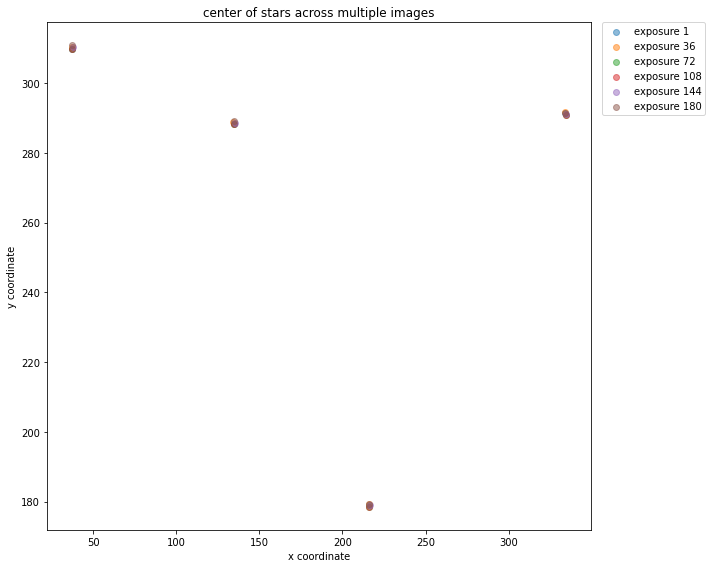

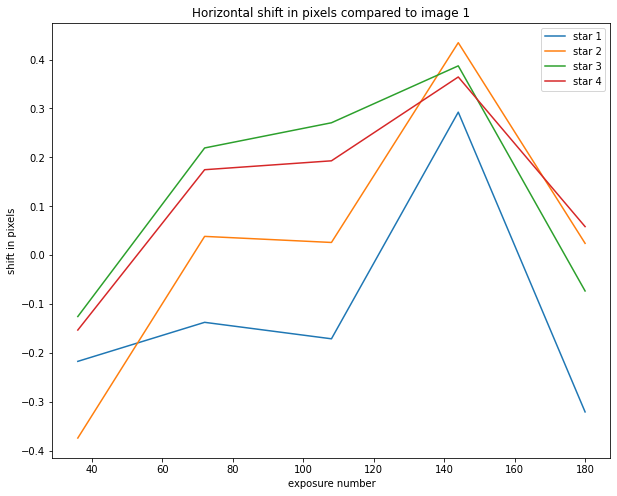

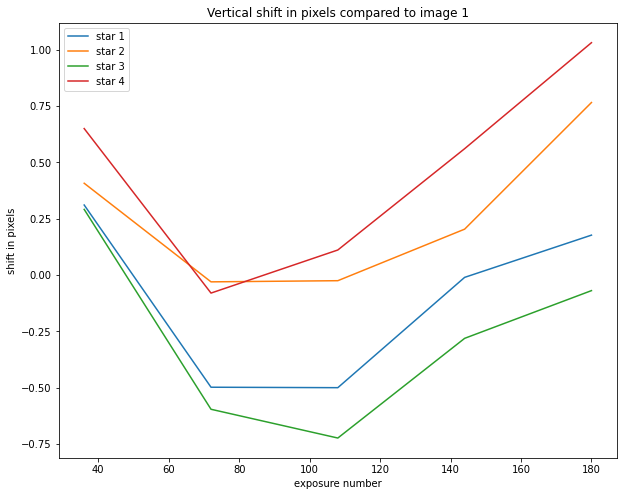

In [53]:
#plots the corrected images to see how much their values change

output_aug_shift = []


#adds all the output from each function into one list
output_aug_shift.append(offset(aug_1_pos,aug36_pos_correct))
output_aug_shift.append(offset(aug_1_pos,aug72_pos_correct))
output_aug_shift.append(offset(aug_1_pos,aug108_pos_correct))
output_aug_shift.append(offset(aug_1_pos,aug144_pos_correct))
output_aug_shift.append(offset(aug_1_pos,aug180_pos_correct))

#labels the stars based on their image number
star_number_aug_correct = [36,72,108,144,180]
num_stars_aug_shift = len(output_aug_shift[0][0])

hor_aug_new, ver_aug_new = pixel_shift(output_aug_shift,star_number_aug_correct,num_stars_aug_shift)

plt.scatter(aug_1_pos['x'],aug_1_pos['y'], alpha = 0.5, label = "exposure 1")
plt.scatter(aug36_pos_correct['x'],aug36_pos_correct['y'], alpha = 0.5, label = "exposure 36")
plt.scatter(aug72_pos_correct['x'],aug72_pos_correct['y'], alpha = 0.5, label = "exposure 72")
plt.scatter(aug108_pos_correct['x'],aug108_pos_correct['y'], alpha = 0.5, label = "exposure 108")
plt.scatter(aug144_pos_correct['x'],aug144_pos_correct['y'], alpha = 0.5, label = "exposure 144")
plt.scatter(aug180_pos_correct['x'],aug180_pos_correct['y'], alpha = 0.5, label = "exposure 180")
plt.legend()
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("center of stars across multiple images")
plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.tight_layout()  # Ensures everything fits nicely
plt.savefig("star2 center fixed")
plt.show()

pixel_plot(star_number_aug_correct ,hor_aug_new,ver_aug_new)

<span style="font-size: 18pt;">The below section involves stacking the adjusted images.</span>


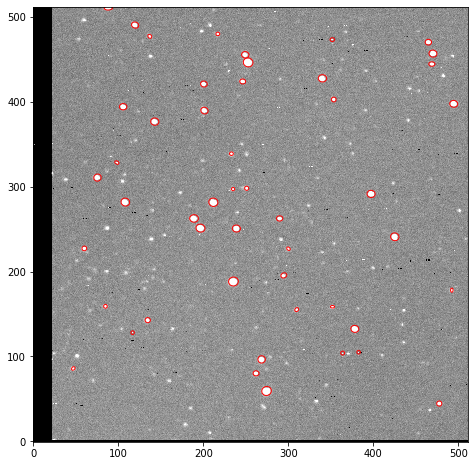

49


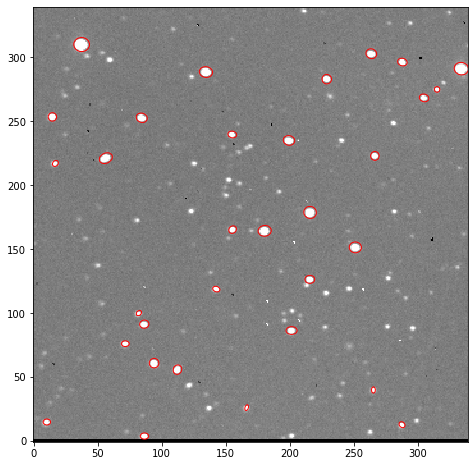

32


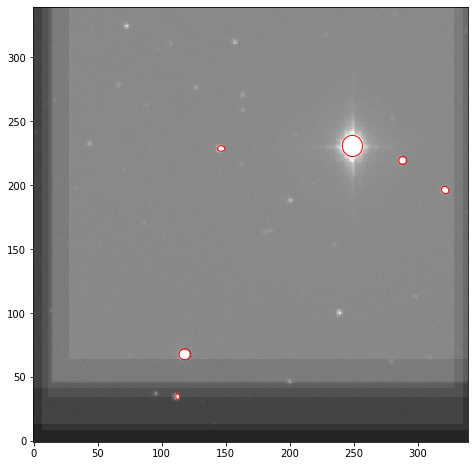

6


In [54]:
#stacking the aligned images
v404_stack = v4041+ v404100_shift + v404200_shift + v404300_shift + v404400_shift + v404414_shift
aug_stack = aug1_sq + aug36_shift + aug72_shift + aug108_shift + aug144_shift + aug180_shift
jul_stack = jul1_sq + jul100_shift + jul200_shift + jul300_shift + jul400_shift + jul500_shift + jul600_shift + jul643_shift

v404_final = star_counter(v404_stack,np.mean(v404_stack)+np.std(v404_stack))
aug_final = star_counter(aug_stack,np.mean(aug_stack)+np.std(aug_stack))
jul_final = star_counter(jul_stack,np.mean(jul_stack)+np.std(jul_stack))